## **CBS Project** - Bike sharing data from Washington, D.C.  

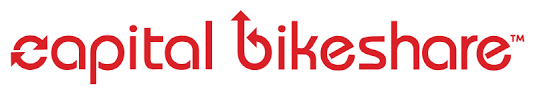

Urban Mobility project focused on analysing Capital BikeShare data. For data access [here](https://capitalbikeshare.com/system-data).    

In [1]:
# importing known relevant modules (at top for quick future reference)
import numpy as np
import pandas as pd
from datetime import datetime
import matplotlib.pyplot as plt
from matplotlib.sankey import Sankey
import plotly.graph_objects as go
import seaborn as sns
import scipy.stats as stats
from sklearn import preprocessing as sk
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn import linear_model
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import accuracy_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import MinMaxScaler, RobustScaler, StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn import svm
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import classification_report
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import cohen_kappa_score
from sklearn.model_selection import cross_val_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import GradientBoostingClassifier
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import ComplementNB
from sklearn.model_selection import cross_val_predict
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import uniform
from scipy.spatial.distance import cdist
import folium
import random
import folium.plugins
from folium.plugins import HeatMap
from folium.plugins import HeatMapWithTime

In [2]:
# reading data sets
df_DailyWeather = pd.read_csv('CBS_2021-2023_Daily_Weather.csv')
df_Full = pd.read_csv('CBS_2021-2023_Full.csv') 
df_HourlyWeather = pd.read_csv('CBS_2021-2023_Hourly_Weather.csv') 
df_stationLoc = pd.read_csv('Capital_Bikeshare_Locations.csv') 

C:\Users\EWF\AppData\Local\Temp\ipykernel_18364\524021929.py:3: DtypeWarning: Columns (5,7) have mixed types. Specify dtype option on import or set low_memory=False.
  df_Full = pd.read_csv('CBS_2021-2023_Full.csv')


### **Step 1** - Data Wrangling 
1. Initial data overview
1. Renaming/editing columns
1. Missing data (filling/dropping/New Features)
1. Duplicates
1. Data types (int, float, str, cat, datetime)
1. Combining and merging datasets (?)



**Initial Data Overview**  

In [3]:
df_DailyWeather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1095 entries, 0 to 1094
Data columns (total 8 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Casual                          1095 non-null   int64  
 1   Date                            1095 non-null   object 
 2   Member                          1095 non-null   int64  
 3   Total_rides                     1095 non-null   int64  
 4   apparent_temperature_mean (°C)  1095 non-null   float64
 5   temperature_2m_mean (°C)        1095 non-null   float64
 6   weathercode (wmo code)          1095 non-null   int64  
 7   windspeed_10m_max (km/h)        1095 non-null   float64
dtypes: float64(3), int64(4), object(1)
memory usage: 68.6+ KB


In [4]:
df_Full.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10693997 entries, 0 to 10693996
Data columns (total 13 columns):
 #   Column              Dtype  
---  ------              -----  
 0   ride_id             object 
 1   rideable_type       object 
 2   started_at          object 
 3   ended_at            object 
 4   start_station_name  object 
 5   start_station_id    object 
 6   end_station_name    object 
 7   end_station_id      object 
 8   start_lat           float64
 9   start_lng           float64
 10  end_lat             float64
 11  end_lng             float64
 12  member_casual       object 
dtypes: float64(4), object(9)
memory usage: 1.0+ GB


In [5]:
df_DailyWeather.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1095 entries, 0 to 1094
Data columns (total 8 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   Casual                          1095 non-null   int64  
 1   Date                            1095 non-null   object 
 2   Member                          1095 non-null   int64  
 3   Total_rides                     1095 non-null   int64  
 4   apparent_temperature_mean (°C)  1095 non-null   float64
 5   temperature_2m_mean (°C)        1095 non-null   float64
 6   weathercode (wmo code)          1095 non-null   int64  
 7   windspeed_10m_max (km/h)        1095 non-null   float64
dtypes: float64(3), int64(4), object(1)
memory usage: 68.6+ KB


In [6]:
print('Daily - shape',df_DailyWeather.shape)
print('Full - shape', df_Full.shape)
print('Hourly - Shape',df_HourlyWeather.shape)
print('Stations - Shape',df_stationLoc.shape)

Daily - shape (1095, 8)
Full - shape (10693997, 13)
Hourly - Shape (26280, 9)
Stations - Shape (765, 29)


In [7]:
df_HourlyWeather.head()

,Casual,Date,Hour,Member,Total_rides,relativehumidity_2m (%),temperature_2m (°C),weathercode (wmo code),windspeed_10m (km/h)
0,20.0,2021-01-01,0,26.0,46.0,90,2.4,1,10.2
1,23.0,2021-01-01,1,23.0,46.0,88,1.8,1,10.0
2,20.0,2021-01-01,2,28.0,48.0,87,1.1,2,10.1
3,9.0,2021-01-01,3,7.0,16.0,81,1.6,2,10.6
4,7.0,2021-01-01,4,5.0,12.0,77,1.6,2,9.9


In [8]:
df_Full.head()

,ride_id,rideable_type,started_at,ended_at,start_station_name,start_station_id,end_station_name,end_station_id,start_lat,start_lng,end_lat,end_lng,member_casual
0,5CB9DFCECF79AF84,classic_bike,2021-01-01 00:08:33,2021-01-01 00:33:53,Maine Ave & 9th St SW,31646.0,Rosslyn Metro / Wilson Blvd & Ft Myer Dr,31015.0,38.880440,-77.025236,38.894600,-77.072305,member
1,629E059504606547,electric_bike,2021-01-01 00:13:43,2021-01-01 00:29:34,10th & U St NW,31111.0,NaN,NaN,38.917193,-77.025894,38.960000,-77.020000,casual
2,E74069873161EE33,electric_bike,2021-01-01 00:14:32,2021-01-01 00:28:45,17th & Corcoran St NW,31214.0,14th & Belmont St NW,31119.0,38.912138,-77.038568,38.920870,-77.031691,member
3,91F95E512CABC46A,classic_bike,2021-01-01 00:15:45,2021-01-01 00:21:20,Wilson Blvd. & N. Vermont St.,31926.0,Wilson Blvd. & N. Vermont St.,31926.0,38.879477,-77.114563,38.879477,-77.114563,member
4,DA46A05139C0EA2F,classic_bike,2021-01-01 00:17:46,2021-01-01 00:21:00,11th & Park Rd NW,31651.0,14th & Newton St NW,31649.0,38.931322,-77.028247,38.931991,-77.032956,member


In [9]:
df_stationLoc.head()

,X,Y,NAME,STATION_TYPE,STATION_ID,STATION_STATUS,LAST_REPORTED,NUM_DOCKS_AVAILABLE,NUM_DOCKS_DISABLED,NUM_BIKES_AVAILABLE,...,EIGHTD_HAS_KEY_DISPENSER,CAPACITY,RENTAL_METHODS,REGION_ID,REGION_NAME,GIS_ID,LATITUDE,LONGITUDE,GIS_LAST_MOD_DTTM,OBJECTID
0,-77.032297,38.908604,14th St & Rhode Island Ave NW,classic,08247a21-1f3f-11e7-bf6b-3863bb334450,NaN,2024/03/19 15:05:19+00,26,0,4,...,NO,31,"KEY,CREDITCARD",42.0,DCA-CABI,NaN,38.908600,-77.032300,2024/03/19 15:07:27+00,169701679
1,-77.021551,38.947972,Kansas Ave & Sherman Cr NW,classic,c645ddde-0156-47ab-9616-3121f541a6f0,NaN,2024/03/19 15:05:19+00,5,0,14,...,NO,19,"KEY,CREDITCARD",42.0,DCA-CABI,NaN,38.947962,-77.021550,2024/03/19 15:07:27+00,169701680
2,-77.363099,38.955176,Town Center Pkwy & Sunset Hills Rd,classic,082653a6-1f3f-11e7-bf6b-3863bb334450,NaN,2024/03/19 15:05:18+00,7,0,3,...,NO,11,"KEY,CREDITCARD",104.0,DCA-CABI,NaN,38.955171,-77.363094,2024/03/19 15:07:27+00,169701681
3,-77.032953,38.931998,14th & Newton St NW,classic,e9030e46-31bf-4def-befb-2e685ad48180,NaN,2024/03/19 15:05:15+00,18,0,1,...,NO,19,"KEY,CREDITCARD",42.0,DCA-CABI,NaN,38.931991,-77.032956,2024/03/19 15:07:27+00,169701682
4,-77.016058,38.782642,Fleet St & Waterfront St,classic,d4e8307d-5fb2-4ece-a66a-1522b1ebf79c,NaN,2024/03/19 15:05:15+00,4,0,11,...,NO,15,"KEY,CREDITCARD",133.0,DCA-CABI,NaN,38.782633,-77.016059,2024/03/19 15:07:27+00,169701683


**Editing and Renaming columns** 

In [10]:
df_DailyWeather.head(0)

,Casual,Date,Member,Total_rides,apparent_temperature_mean (°C),temperature_2m_mean (°C),weathercode (wmo code),windspeed_10m_max (km/h)


In [11]:
# renaming columns to reader-friendly uppercase format and alining hourly and daily labels 
df_Full.rename(columns={'ride_id':'Ride ID', 'rideable_type':'Bike Type', 'started_at':'Start Time', 'ended_at':'End Time',	'start_station_name':'Start Station', 'start_station_id':'Start Station ID', 'end_station_name':'End Station', 'end_station_id':'End Station ID', 'start_lat':'Start Lat', 'start_lng':'Start Lng', 'end_lat':'End Lat', 'end_lng':'End Lng', 'member_casual':'Rider Type'}, inplace=True)
df_DailyWeather.rename(columns={'Casual':'Casual', 'Date':'Date','Hour':'Hour',	'Member':'Member', 'Total_rides':'Total Rides', 'relativehumidity_2m (%)':'Humidity (%)','temperature_2m_mean (°C)':'Avg. Temperature (°C)', 'apparent_temperature_mean (°C)':'Avg. "Feels like" (°C)', 'temperature_2m (°C)':'Temperature (°C)','weathercode (wmo code)':'WMO Code', 'windspeed_10m (km/h)':'Wind (km/h)', 'windspeed_10m_max (km/h)':'Max Wind (km/h)'}, inplace=True)
df_HourlyWeather.rename(columns={'Casual':'Casual', 'Date':'Date','Hour':'Hour', 'Member':'Member', 'Total_rides':'Total Rides', 'relativehumidity_2m (%)':'Humidity (%)','temperature_2m_mean (°C)':'Avg. Temperature (°C)', 'apparent_temperature_mean (°C)':'Avg. "Feels like" (°C)', 'temperature_2m (°C)':'Temperature (°C)','weathercode (wmo code)':'WMO Code', 'windspeed_10m (km/h)':'Wind (km/h)', 'windspeed_10m_max (km/h)':'Max Wind (km/h)'}, inplace=True)

In [12]:
# creating new DF with only relevant columns for stations 
df_stations= df_stationLoc.drop(columns=['X', 'Y', 'STATION_TYPE', 'STATION_STATUS','LAST_REPORTED','NUM_DOCKS_AVAILABLE','NUM_DOCKS_DISABLED', 'NUM_BIKES_AVAILABLE','NUM_BIKES_DISABLED', 'IS_INSTALLED', 'IS_RETURNING','IS_RENTING', 'HAS_KIOSK', 'IOS', 'ANDROID','ELECTRIC_BIKE_SURCHARGE_WAIVER','EIGHTD_HAS_KEY_DISPENSER', 'RENTAL_METHODS','REGION_ID', 'REGION_NAME','GIS_ID', 'GIS_LAST_MOD_DTTM', 'OBJECTID'])

In [13]:
# modifying columns' index to have an organised header
df_DailyWeather = df_DailyWeather.reindex(columns= ['Date', 'Casual', 'Member', 'Total Rides', 'Avg. "Feels like" (°C)', 'Avg. Temperature (°C)', 'WMO Code', 'Max Wind (km/h)'])
df_HourlyWeather = df_HourlyWeather.reindex(columns= ['Date', 'Hour', 'Casual', 'Member', 'Total Rides', 'Humidity (%)', 'Temperature (°C)', 'WMO Code', 'Wind (km/h)'])

**Missing data (filling/dropping/new features)**

In [14]:
df_HourlyWeather.head(5)

,Date,Hour,Casual,Member,Total Rides,Humidity (%),Temperature (°C),WMO Code,Wind (km/h)
0,2021-01-01,0,20.0,26.0,46.0,90,2.4,1,10.2
1,2021-01-01,1,23.0,23.0,46.0,88,1.8,1,10.0
2,2021-01-01,2,20.0,28.0,48.0,87,1.1,2,10.1
3,2021-01-01,3,9.0,7.0,16.0,81,1.6,2,10.6
4,2021-01-01,4,7.0,5.0,12.0,77,1.6,2,9.9


In [15]:
# review of weather code counts across data
df_HourlyWeather['WMO Code'].value_counts()

WMO Code
0     11431
1      6003
3      3290
2      2507
51     1394
53      602
61      400
63      222
55      194
71      102
73       90
75       28
65       17
Name: count, dtype: int64

In [16]:
# for daily → adding new column with user friendly translation of WMO Code
df_DailyWeather['Weather'] = df_DailyWeather['WMO Code'].apply(lambda value: 'Clear'
if value == 0 else 'Mostly Clear' 
if value == 1 else 'Cloudy'
if value == 3 else 'Partly Cloudy'
if value == 2 else 'Light Drizzle'
if value == 51 else 'Heavy Drizzle'
if value == 53 else 'Light Rain'
if value == 61 else 'Rain'
if value == 63 else 'Heavy Drizzle'
if value == 55 else 'Light Snow'
if value == 71 else 'Snow'
if value == 73 else 'Heavy Snow'
if value == 75 else 'Heavy Rain')


In [17]:
# for hourly → adding new column with user friendly translation of WMO Code
df_HourlyWeather['Weather'] = df_HourlyWeather['WMO Code'].apply(lambda value: 'Clear'
if value == 0 else 'Mostly Clear'
if value == 1 else 'Cloudy'
if value == 3 else 'Partly Cloudy'
if value == 2 else 'Light Drizzle'
if value == 51 else 'Heavy Drizzle'
if value == 53 else 'Light Rain'
if value == 61 else 'Rain'
if value == 63 else 'Heavy Drizzle'
if value == 55 else 'Light Snow'
if value == 71 else 'Snow'
if value == 73 else 'Heavy Snow'
if value == 75 else 'Heavy Rain')

In [18]:
# reindexing columns again to incorporate the Weather column to its right position
# modifying columns' index to have an organised header
df_DailyWeather = df_DailyWeather.reindex(columns= ['Date', 'Casual', 'Member', 'Total Rides', 'Avg. "Feels like" (°C)', 'Avg. Temperature (°C)', 'WMO Code', 'Weather', 'Max Wind (km/h)'])
df_HourlyWeather = df_HourlyWeather.reindex(columns= ['Date', 'Hour', 'Casual', 'Member', 'Total Rides', 'Humidity (%)', 'Temperature (°C)', 'WMO Code', 'Weather', 'Wind (km/h)'])

In [19]:
df_HourlyWeather.head()

,Date,Hour,Casual,Member,Total Rides,Humidity (%),Temperature (°C),WMO Code,Weather,Wind (km/h)
0,2021-01-01,0,20.0,26.0,46.0,90,2.4,1,Mostly Clear,10.2
1,2021-01-01,1,23.0,23.0,46.0,88,1.8,1,Mostly Clear,10.0
2,2021-01-01,2,20.0,28.0,48.0,87,1.1,2,Partly Cloudy,10.1
3,2021-01-01,3,9.0,7.0,16.0,81,1.6,2,Partly Cloudy,10.6
4,2021-01-01,4,7.0,5.0,12.0,77,1.6,2,Partly Cloudy,9.9


In [20]:
# obtain remaining NaN values in columns 
df_Full.isnull().sum()

Ride ID                  0
Bike Type                0
Start Time               0
End Time                 0
Start Station       742776
Start Station ID    742776
End Station         811282
End Station ID      811282
Start Lat                2
Start Lng                2
End Lat              16765
End Lng              16765
Rider Type               0
dtype: int64

In [21]:
# finding remaining NaN values in the df_Full

print ('Index for missing values include:', np.where(df_Full['Start Lat'].isna()),'\n\n')
print(df_Full[df_Full['Start Lat'].isna()])

Index for missing values include: (array([133129, 143000], dtype=int64),) 


                 Ride ID    Bike Type           Start Time  \
133129  76C50D7330BD4ECA  docked_bike  2021-02-12 17:04:26   
143000  E1808D56BF23C00F  docked_bike  2021-02-17 00:54:05   

                   End Time Start Station Start Station ID  End Station  \
133129  2021-02-12 17:12:10   MTL-ECO5-03      MTL-ECO5-03  MTL-ECO5-03   
143000  2021-02-17 00:54:17   MTL-ECO5-03      MTL-ECO5-03  MTL-ECO5-03   

       End Station ID  Start Lat  Start Lng  End Lat  End Lng Rider Type  
133129    MTL-ECO5-03        NaN        NaN      NaN      NaN     member  
143000    MTL-ECO5-03        NaN        NaN      NaN      NaN     member  


In [22]:
# dropping the rows with "MTL-ECO5-03" start/end stations 
df_Full = df_Full.drop(axis=0, index=[133129,143000])

In [23]:
df_Full.head()

,Ride ID,Bike Type,Start Time,End Time,Start Station,Start Station ID,End Station,End Station ID,Start Lat,Start Lng,End Lat,End Lng,Rider Type
0,5CB9DFCECF79AF84,classic_bike,2021-01-01 00:08:33,2021-01-01 00:33:53,Maine Ave & 9th St SW,31646.0,Rosslyn Metro / Wilson Blvd & Ft Myer Dr,31015.0,38.880440,-77.025236,38.894600,-77.072305,member
1,629E059504606547,electric_bike,2021-01-01 00:13:43,2021-01-01 00:29:34,10th & U St NW,31111.0,NaN,NaN,38.917193,-77.025894,38.960000,-77.020000,casual
2,E74069873161EE33,electric_bike,2021-01-01 00:14:32,2021-01-01 00:28:45,17th & Corcoran St NW,31214.0,14th & Belmont St NW,31119.0,38.912138,-77.038568,38.920870,-77.031691,member
3,91F95E512CABC46A,classic_bike,2021-01-01 00:15:45,2021-01-01 00:21:20,Wilson Blvd. & N. Vermont St.,31926.0,Wilson Blvd. & N. Vermont St.,31926.0,38.879477,-77.114563,38.879477,-77.114563,member
4,DA46A05139C0EA2F,classic_bike,2021-01-01 00:17:46,2021-01-01 00:21:00,11th & Park Rd NW,31651.0,14th & Newton St NW,31649.0,38.931322,-77.028247,38.931991,-77.032956,member


In [24]:
df_Full.isnull().sum()

Ride ID                  0
Bike Type                0
Start Time               0
End Time                 0
Start Station       742776
Start Station ID    742776
End Station         811282
End Station ID      811282
Start Lat                0
Start Lng                0
End Lat              16763
End Lng              16763
Rider Type               0
dtype: int64

In [25]:
df_Full[(df_Full['Bike Type'] == "electric_bike") & (pd.isna(df_Full['Start Station']))]

,Ride ID,Bike Type,Start Time,End Time,Start Station,Start Station ID,End Station,End Station ID,Start Lat,Start Lng,End Lat,End Lng,Rider Type
5,0FD3B4B2152425C3,electric_bike,2021-01-01 00:18:16,2021-01-01 00:29:05,NaN,NaN,Georgia Ave & Kennedy St NW,31415.0,38.93,-77.03,38.956738,-77.027940,casual
20,997E8E08C493F034,electric_bike,2021-01-01 00:27:18,2021-01-01 00:34:30,NaN,NaN,NaN,NaN,38.99,-77.03,38.990000,-77.030000,member
22,87E06BFC439643DA,electric_bike,2021-01-01 00:32:44,2021-01-01 00:32:51,NaN,NaN,NaN,NaN,38.89,-76.99,38.890000,-76.990000,casual
24,6E4F247C2E3358BA,electric_bike,2021-01-01 00:35:51,2021-01-01 00:37:57,NaN,NaN,Lincoln Park / 13th & East Capitol St NE,31619.0,38.89,-76.99,38.890484,-76.988408,casual
37,60807578738CDEB8,electric_bike,2021-01-01 00:50:13,2021-01-01 00:57:14,NaN,NaN,NaN,NaN,38.95,-77.03,38.930000,-77.040000,casual
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10693955,A7B09070FCF499EB,electric_bike,2023-12-31 23:43:05,2023-12-31 23:46:24,NaN,NaN,NaN,NaN,38.94,-77.03,38.940000,-77.020000,casual
10693961,8849112D688B0459,electric_bike,2023-12-31 23:45:13,2024-01-01 00:02:39,NaN,NaN,11th & M St NW,31266.0,38.88,-77.03,38.905578,-77.027313,casual
10693965,3D9C23043451AF9C,electric_bike,2023-12-31 23:46:57,2024-01-01 00:03:20,NaN,NaN,14th St & Spring Rd NW,31401.0,38.91,-77.04,38.937500,-77.032800,member
10693974,4D77E3EF9A1126E0,electric_bike,2023-12-31 23:50:12,2023-12-31 23:53:09,NaN,NaN,Adams Mill & Columbia Rd NW,31104.0,38.93,-77.03,38.922849,-77.042525,member


In [26]:
# assining e-bike "parked in street" as station name to replace NaN values in Start Station column 

# df_Full[(df_Full['Bike Type'] == "electric_bike") & (pd.isna(df_Full['Start Station']))] → use of this code will filter for observation before implementation 
# df_Full[(df_Full['Bike Type'] == "electric_bike") & (pd.isna(df_Full['End Station']))] → use of this code will filter for observation before implementation

df_Full.loc[df_Full['Bike Type'] == 'electric_bike', 'Start Station'] = df_Full.loc[df_Full['Bike Type'] == 'electric_bike', 'Start Station'].fillna("Parked in Street")


In [27]:
# assining e-bike "parked in street" as station name to replace NaN values in End Station column

df_Full.loc[df_Full['Bike Type'] == 'electric_bike', 'End Station'] = df_Full.loc[df_Full['Bike Type'] == 'electric_bike', 'End Station'].fillna("Parked in Street")

In [28]:
# assining e-bike Station IDs as 00 station ID for e-bikes with NaN values (i.e., parked in street)

df_Full.loc[df_Full['Bike Type'] == 'electric_bike', 'Start Station ID'] = df_Full.loc[df_Full['Bike Type'] == 'electric_bike', 'Start Station ID'].fillna(00)
df_Full.loc[df_Full['Bike Type'] == 'electric_bike', 'End Station ID'] = df_Full.loc[df_Full['Bike Type'] == 'electric_bike', 'End Station ID'].fillna(00)

In [29]:
df_test = df_Full[(pd.isna(df_Full['End Station']))]

In [30]:
df_test['Bike Type'].value_counts()

Bike Type
classic_bike    19895
docked_bike      5136
Name: count, dtype: int64

In [31]:
df_Full.isnull().sum()

Ride ID                 0
Bike Type               0
Start Time              0
End Time                0
Start Station          10
Start Station ID       10
End Station         25031
End Station ID      25031
Start Lat               0
Start Lng               0
End Lat             16763
End Lng             16763
Rider Type              0
dtype: int64

In [32]:
# for docked bikes renaming End Station name to "Not Returned"
df_Full.loc[df_Full['Bike Type'] == 'docked_bike', 'End Station'] = df_Full.loc[df_Full['Bike Type'] == 'docked_bike', 'End Station'].fillna('Not Returned')

In [33]:
# for docked bikes assigning generic End Lat/Lng coordinates of Washington D.C. 38.889805, -77.009056 
df_Full.loc[df_Full['Bike Type'] == 'docked_bike', 'End Lat'] = df_Full.loc[df_Full['Bike Type'] == 'docked_bike', 'End Lat'].fillna(38.889805)
df_Full.loc[df_Full['Bike Type'] == 'docked_bike', 'End Lng'] = df_Full.loc[df_Full['Bike Type'] == 'docked_bike', 'End Lng'].fillna(-77.009056)

In [34]:
df_Full.isnull().sum()

Ride ID                 0
Bike Type               0
Start Time              0
End Time                0
Start Station          10
Start Station ID       10
End Station         19895
End Station ID      25031
Start Lat               0
Start Lng               0
End Lat             11627
End Lng             11627
Rider Type              0
dtype: int64

In [35]:
df_test[(df_test['Bike Type'] == "classic_bike") & (pd.isna(df_test['End Station']))]

,Ride ID,Bike Type,Start Time,End Time,Start Station,Start Station ID,End Station,End Station ID,Start Lat,Start Lng,End Lat,End Lng,Rider Type
323,19A6B2FB77AB963C,classic_bike,2021-01-01 09:30:20,2021-01-01 11:21:33,Tenleytown / Wisconsin Ave & Albemarle St NW,31303.0,NaN,NaN,38.947607,-77.079382,NaN,NaN,casual
561,38D717869E1FCE4D,classic_bike,2021-01-01 12:57:44,2021-01-01 16:19:10,Lincoln Memorial,31258.0,NaN,NaN,38.888255,-77.049436,NaN,NaN,member
671,A065F84C99F27AF4,classic_bike,2021-01-01 14:20:37,2021-01-01 14:47:40,Arlington Blvd & N Queen St,31051.0,NaN,NaN,38.889365,-77.077294,38.91,-77.07,member
1648,FCB1785D2FEDEE3C,classic_bike,2021-01-02 11:08:22,2021-01-02 11:33:36,Roosevelt Island,31062.0,NaN,NaN,38.896553,-77.067140,38.86,-77.05,casual
1649,9FA222683B8CA273,classic_bike,2021-01-02 11:08:23,2021-01-02 11:33:36,Roosevelt Island,31062.0,NaN,NaN,38.896553,-77.067140,38.86,-77.05,member
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10691132,3F8532668AA7F819,classic_bike,2023-12-31 15:52:03,2024-01-01 16:51:59,1st & Q St SW,31676.0,NaN,NaN,38.870824,-77.011915,NaN,NaN,casual
10691183,AB96A405EC88BC37,classic_bike,2023-12-31 15:57:04,2024-01-01 16:56:58,1st & N St SE,31209.0,NaN,NaN,38.875023,-77.005754,NaN,NaN,member
10691725,EC32D807C14F833B,classic_bike,2023-12-31 16:47:09,2024-01-01 17:47:02,Alabama Ave & Stanton Rd SE / Shops at Park Vi...,31813.0,NaN,NaN,38.846270,-76.981850,NaN,NaN,casual
10693231,E88253B06CA516EA,classic_bike,2023-12-31 20:33:50,2024-01-01 21:33:36,22nd St & Constitution Ave NW,31292.0,NaN,NaN,38.892441,-77.048947,NaN,NaN,casual


In [36]:
df_test[(df_test['Bike Type'] == "classic_bike") & (pd.isna(df_test['End Station'])) & (pd.isna(df_test['End Lat']))]

,Ride ID,Bike Type,Start Time,End Time,Start Station,Start Station ID,End Station,End Station ID,Start Lat,Start Lng,End Lat,End Lng,Rider Type
323,19A6B2FB77AB963C,classic_bike,2021-01-01 09:30:20,2021-01-01 11:21:33,Tenleytown / Wisconsin Ave & Albemarle St NW,31303.0,NaN,NaN,38.947607,-77.079382,NaN,NaN,casual
561,38D717869E1FCE4D,classic_bike,2021-01-01 12:57:44,2021-01-01 16:19:10,Lincoln Memorial,31258.0,NaN,NaN,38.888255,-77.049436,NaN,NaN,member
3631,7CAB1750EC05A176,classic_bike,2021-01-02 14:18:26,2021-01-02 15:39:59,Woodglen Dr & Executive Blvd,32078.0,NaN,NaN,39.043170,-77.113500,NaN,NaN,member
3634,B3A700D8BC7C768B,classic_bike,2021-01-02 14:18:47,2021-01-02 15:40:08,Woodglen Dr & Executive Blvd,32078.0,NaN,NaN,39.043170,-77.113500,NaN,NaN,member
4170,E52113CBE85A310A,classic_bike,2021-01-02 14:55:47,2021-01-02 15:13:20,Columbus Circle / Union Station,31623.0,NaN,NaN,38.896960,-77.004930,NaN,NaN,member
...,...,...,...,...,...,...,...,...,...,...,...,...,...
10691132,3F8532668AA7F819,classic_bike,2023-12-31 15:52:03,2024-01-01 16:51:59,1st & Q St SW,31676.0,NaN,NaN,38.870824,-77.011915,NaN,NaN,casual
10691183,AB96A405EC88BC37,classic_bike,2023-12-31 15:57:04,2024-01-01 16:56:58,1st & N St SE,31209.0,NaN,NaN,38.875023,-77.005754,NaN,NaN,member
10691725,EC32D807C14F833B,classic_bike,2023-12-31 16:47:09,2024-01-01 17:47:02,Alabama Ave & Stanton Rd SE / Shops at Park Vi...,31813.0,NaN,NaN,38.846270,-76.981850,NaN,NaN,casual
10693231,E88253B06CA516EA,classic_bike,2023-12-31 20:33:50,2024-01-01 21:33:36,22nd St & Constitution Ave NW,31292.0,NaN,NaN,38.892441,-77.048947,NaN,NaN,casual


In [37]:
df_Full.isna().sum()

Ride ID                 0
Bike Type               0
Start Time              0
End Time                0
Start Station          10
Start Station ID       10
End Station         19895
End Station ID      25031
Start Lat               0
Start Lng               0
End Lat             11627
End Lng             11627
Rider Type              0
dtype: int64

In [38]:
# for classic bikes - filling NaN values in End Station when both End Station when both End Lat are unknown

df_Full.loc[(df_Full['Bike Type'] == "classic_bike") & (pd.isna(df_Full['End Station'])) & (pd.isna(df_Full['End Lat'])), 'End Station'] = "Whereabouts Unknown" 

In [39]:
df_unkown = df_Full[df_Full['End Station'] == "Whereabouts Unknown"]
df_unkown.shape

(11627, 13)

In [40]:
# for classic bikes - filling NaN values in Coordinates in End Lat/Lng when both End Station when both End Lat/Lng are unknown
df_Full.loc[(df_Full['Bike Type'] == "classic_bike") & (df_Full['End Station'] == "Whereabouts Unknown") & (pd.isna(df_Full['End Lat'])), 'End Lat'] = 29.48003
df_Full.loc[(df_Full['Bike Type'] == "classic_bike") & (df_Full['End Station'] == "Whereabouts Unknown") & (pd.isna(df_Full['End Lng'])), 'End Lng'] = -37.62424

In [41]:
df_Full.isna().sum()

Ride ID                 0
Bike Type               0
Start Time              0
End Time                0
Start Station          10
Start Station ID       10
End Station          8268
End Station ID      25031
Start Lat               0
Start Lng               0
End Lat                 0
End Lng                 0
Rider Type              0
dtype: int64

In [42]:
# for classic bikes → filling in NaN in End Station with "Parked in Street" when there is End Lat is True but End Station is NaN (implemented code above leads identifying remaining street-parked bikes)   
df_Full.loc[(pd.isna(df_Full['End Station'])), 'End Station'] = "Parked in Street"

In [43]:
df_Full.isna().sum()

Ride ID                 0
Bike Type               0
Start Time              0
End Time                0
Start Station          10
Start Station ID       10
End Station             0
End Station ID      25031
Start Lat               0
Start Lng               0
End Lat                 0
End Lng                 0
Rider Type              0
dtype: int64

In [44]:
# remaining rides → filling in NaN in "End Station ID" with 00   
df_Full.loc[(pd.isna(df_Full['End Station ID'])), 'End Station ID'] = 00


In [45]:
df_Full.isna().sum()

Ride ID              0
Bike Type            0
Start Time           0
End Time             0
Start Station       10
Start Station ID    10
End Station          0
End Station ID       0
Start Lat            0
Start Lng            0
End Lat              0
End Lng              0
Rider Type           0
dtype: int64

In [46]:
df_Full.isna().sum()

Ride ID              0
Bike Type            0
Start Time           0
End Time             0
Start Station       10
Start Station ID    10
End Station          0
End Station ID       0
Start Lat            0
Start Lng            0
End Lat              0
End Lng              0
Rider Type           0
dtype: int64

In [47]:
df_test = df_Full[(pd.isna(df_Full['Start Station']))]

In [48]:
df_test

,Ride ID,Bike Type,Start Time,End Time,Start Station,Start Station ID,End Station,End Station ID,Start Lat,Start Lng,End Lat,End Lng,Rider Type
9527855,A512EA4D5EF2EFE1,classic_bike,2023-09-28 18:43:00,2023-09-28 18:59:04,NaN,NaN,Parked in Street,0,38.90,-77.03,38.900000,-77.030000,member
9529739,9AE8D3ED6DEFD203,classic_bike,2023-09-28 20:12:05,2023-09-28 22:52:12,NaN,NaN,15th St & Pennsylvania Ave NW,31129.0,38.88,-77.04,38.896465,-77.033381,casual
9561483,B0A2B6B86FFF4D5E,classic_bike,2023-09-30 17:41:52,2023-09-30 17:56:59,NaN,NaN,10th St & Spring Rd NW,31426.0,38.89,-77.03,38.936228,-77.027163,member
9563228,78E909F226C1C0DC,classic_bike,2023-09-30 18:53:50,2023-09-30 19:02:35,NaN,NaN,37th & O St NW / Georgetown University,31236.0,38.91,-77.08,38.907837,-77.071660,member
9564598,E4EBEAD1F08917C2,classic_bike,2023-09-30 20:08:18,2023-09-30 20:43:13,NaN,NaN,King St Metro North / Cameron St,31098.0,38.80,-77.04,38.807040,-77.059817,casual
9573560,3210228937E349C3,classic_bike,2023-10-01 12:44:04,2023-10-01 12:51:57,NaN,NaN,17th & P St NW,31330.0,38.90,-77.03,38.909858,-77.038566,member
9576121,1CDBED5E9D75C660,classic_bike,2023-10-01 14:27:51,2023-10-01 14:52:01,NaN,NaN,37th & O St NW / Georgetown University,31236.0,38.88,-77.01,38.907837,-77.071660,member
9589636,703434458D9C0046,classic_bike,2023-10-02 12:29:02,2023-10-02 12:29:21,NaN,NaN,Kenilworth Terr & Hayes St. NE,31717.0,38.90,-76.95,38.900468,-76.947287,casual
9604731,BF354BA39A9DADB6,classic_bike,2023-10-03 10:23:21,2023-10-03 11:01:28,NaN,NaN,Parked in Street,0,38.92,-77.07,38.920000,-77.070000,casual
10439318,D338BCF7E3938CD1,classic_bike,2023-12-03 02:43:29,2023-12-03 03:04:02,NaN,NaN,4th & C St SW,31243.0,38.91,-77.00,38.886372,-77.017701,member


In [49]:
# dropping remaining 10 rows due to absence of starting station and ID

df_Full.dropna(subset=["Start Station ID"], inplace=True)


In [50]:
df_Full.isna().sum()

Ride ID             0
Bike Type           0
Start Time          0
End Time            0
Start Station       0
Start Station ID    0
End Station         0
End Station ID      0
Start Lat           0
Start Lng           0
End Lat             0
End Lng             0
Rider Type          0
dtype: int64

In [51]:
df_DailyWeather.head()

,Date,Casual,Member,Total Rides,"Avg. ""Feels like"" (°C)",Avg. Temperature (°C),WMO Code,Weather,Max Wind (km/h)
0,2021-01-01,371,590,961,-0.9,2.3,63,Rain,10.6
1,2021-01-02,2874,2844,5718,4.8,7.6,61,Light Rain,19.1
2,2021-01-03,495,1133,1628,0.9,3.9,63,Rain,13.0
3,2021-01-04,907,2074,2981,1.0,4.1,3,Cloudy,13.3
4,2021-01-05,1057,2004,3061,1.4,4.0,51,Light Drizzle,9.2


In [52]:
# modifying time columns into date time for df_DailyWeather  
df_DailyWeather['Date'] = pd.to_datetime(df_DailyWeather['Date'])

In [53]:
# for Daily → cretion of "weekday" column

df_DailyWeather['Weekday'] = df_DailyWeather['Date'].dt.weekday


In [54]:
# in Daily → assiging weekdays in str in Weekday column instead of int
df_DailyWeather['Day'] = df_DailyWeather['Weekday'].apply(lambda value: 'Monday'
if value == 0 else 'Tuesday'
if value == 1 else 'Wednesday'
if value == 2 else 'Thursday'
if value == 3 else 'Friday'
if value == 4 else 'Saturday'
if value == 5 else 'Sunday')

In [55]:
# in Daily → creating a Weekend column

df_DailyWeather['Weekend'] = df_DailyWeather['Day'].apply(lambda value: 'Weekday'
    if value == 'Monday' else 'Weekday'
    if value == 'Tuesday' else 'Weekday'
    if value == 'Wednesday' else 'Weekday'
    if value == 'Thursday' else 'Weekday'
    if value == 'Friday' else 'Weekend')

In [56]:
# for Daily → creating a Year column 
df_DailyWeather['Year'] = df_DailyWeather['Date'].index=pd.to_datetime(df_DailyWeather['Date'], format='%Y-%m-%d').dt.year

In [57]:
df_DailyWeather['Date'].head()

Date
2021   2021-01-01
2021   2021-01-02
2021   2021-01-03
2021   2021-01-04
2021   2021-01-05
Name: Date, dtype: datetime64[ns]

In [58]:
# for Daily → creation of quarter column  

quarters = df_DailyWeather['Date'].dt.to_period('Q').astype(str)
quarter_df = pd.DataFrame({'Quarter': quarters}).reset_index(drop=True)

# Concatenate the quarter DataFrame with the original DataFrame
df_DailyWeather = pd.concat([df_DailyWeather, quarter_df], axis=1)


In [59]:
# for Daily → creation of month column

df_DailyWeather['Month'] = df_DailyWeather['Date'].dt.strftime('%B') 

In [60]:
# for Daily → reindexing the columns created above to correct order 

df_DailyWeather = df_DailyWeather.reindex(columns=['Date',
 'Year',
 'Quarter',
 'Month',
 'Day',
 'Weekend',
 'Casual',
 'Member',
 'Total Rides',
 'Avg. "Feels like" (°C)',
 'Avg. Temperature (°C)',
 'WMO Code',
 'Weather',
 'Max Wind (km/h)'])

In [61]:
df_DailyWeather.head()

,Date,Year,Quarter,Month,Day,Weekend,Casual,Member,Total Rides,"Avg. ""Feels like"" (°C)",Avg. Temperature (°C),WMO Code,Weather,Max Wind (km/h)
0,2021-01-01,2021,2021Q1,January,Friday,Weekday,371,590,961,-0.9,2.3,63,Rain,10.6
1,2021-01-02,2021,2021Q1,January,Saturday,Weekend,2874,2844,5718,4.8,7.6,61,Light Rain,19.1
2,2021-01-03,2021,2021Q1,January,Sunday,Weekend,495,1133,1628,0.9,3.9,63,Rain,13.0
3,2021-01-04,2021,2021Q1,January,Monday,Weekday,907,2074,2981,1.0,4.1,3,Cloudy,13.3
4,2021-01-05,2021,2021Q1,January,Tuesday,Weekday,1057,2004,3061,1.4,4.0,51,Light Drizzle,9.2


In [62]:
df_Full.dtypes

Ride ID              object
Bike Type            object
Start Time           object
End Time             object
Start Station        object
Start Station ID     object
End Station          object
End Station ID       object
Start Lat           float64
Start Lng           float64
End Lat             float64
End Lng             float64
Rider Type           object
dtype: object

In [63]:
# review of trips where End Time is before than Start Time (which is imposible, so likely an entry error)

# Create a boolean mask where 'End Time' is before 'Start Time'
mask = df_Full['End Time'] < df_Full['Start Time']

# Filter the DataFrame to get the rows where 'End Time' is before 'Start Time'
rows_with_issue = df_Full[mask]

**Duplicates check**

In [64]:
print('Full - Number of duplicates is:',(df_Full.duplicated()).sum())
print('Daily - Number of duplicates is:',(df_DailyWeather.duplicated()).sum())
print('Hourly - Number of duplicates is:',(df_HourlyWeather.duplicated()).sum())

Full - Number of duplicates is: 0
Daily - Number of duplicates is: 0
Hourly - Number of duplicates is: 0


**Adjusting Data Types**

In [65]:
df_HourlyWeather.dtypes

Date                 object
Hour                  int64
Casual              float64
Member              float64
Total Rides         float64
Humidity (%)          int64
Temperature (°C)    float64
WMO Code              int64
Weather              object
Wind (km/h)         float64
dtype: object

In [66]:
# modifying time columns into date time for df_Full  
df_Full['Start Time'] = pd.to_datetime(df_Full['Start Time'])
df_Full['End Time'] = pd.to_datetime(df_Full['End Time'])

In [67]:
# modifying time columns into date time for df_HourlyWeather  
df_HourlyWeather['Date'] = pd.to_datetime(df_HourlyWeather['Date'])
df_HourlyWeather['Hour'] = pd.to_datetime(df_HourlyWeather['Hour'], format='%H').dt.strftime('%H:%M') # code will return str so conversion to datetime executed below

In [68]:
# concatenating columns hour and date into single columns while converting to datetime
df_HourlyWeather['Datetime'] = pd.to_datetime(df_HourlyWeather['Date'].dt.strftime('%Y-%m-%d') + ' ' + df_HourlyWeather['Hour'])

# Drop the individual 'Date' and 'Hour' columns, as this DF is focuses on hourly data and the daily data is availble in separate DF 
df_HourlyWeather.drop(['Date', 'Hour'], axis=1, inplace=True)


In [69]:
df_HourlyWeather.head()

,Casual,Member,Total Rides,Humidity (%),Temperature (°C),WMO Code,Weather,Wind (km/h),Datetime
0,20.0,26.0,46.0,90,2.4,1,Mostly Clear,10.2,2021-01-01 00:00:00
1,23.0,23.0,46.0,88,1.8,1,Mostly Clear,10.0,2021-01-01 01:00:00
2,20.0,28.0,48.0,87,1.1,2,Partly Cloudy,10.1,2021-01-01 02:00:00
3,9.0,7.0,16.0,81,1.6,2,Partly Cloudy,10.6,2021-01-01 03:00:00
4,7.0,5.0,12.0,77,1.6,2,Partly Cloudy,9.9,2021-01-01 04:00:00


In [70]:
df_HourlyWeather.head()

,Casual,Member,Total Rides,Humidity (%),Temperature (°C),WMO Code,Weather,Wind (km/h),Datetime
0,20.0,26.0,46.0,90,2.4,1,Mostly Clear,10.2,2021-01-01 00:00:00
1,23.0,23.0,46.0,88,1.8,1,Mostly Clear,10.0,2021-01-01 01:00:00
2,20.0,28.0,48.0,87,1.1,2,Partly Cloudy,10.1,2021-01-01 02:00:00
3,9.0,7.0,16.0,81,1.6,2,Partly Cloudy,10.6,2021-01-01 03:00:00
4,7.0,5.0,12.0,77,1.6,2,Partly Cloudy,9.9,2021-01-01 04:00:00


In [71]:
# identifying NaN values in Hourly set
df_HourlyWeather[df_HourlyWeather.isna().any(axis=1)]

,Casual,Member,Total Rides,Humidity (%),Temperature (°C),WMO Code,Weather,Wind (km/h),Datetime
21853,NaN,NaN,NaN,73,-3.1,0,Clear,5.1,2021-01-21 03:00:00
21854,NaN,NaN,NaN,71,0.4,0,Clear,11.2,2021-01-22 03:00:00
21855,NaN,NaN,NaN,86,0.3,71,Light Snow,19.8,2021-02-02 03:00:00
21856,NaN,NaN,NaN,71,-1.2,3,Cloudy,20.6,2021-02-03 02:00:00
21857,NaN,NaN,NaN,82,-4.0,1,Mostly Clear,7.8,2021-02-09 01:00:00
21858,NaN,NaN,NaN,94,-1.1,71,Light Snow,10.9,2021-02-19 02:00:00
21859,NaN,NaN,NaN,93,-1.6,51,Light Drizzle,10.4,2021-02-19 03:00:00
21860,NaN,NaN,NaN,56,2.9,0,Clear,13.9,2021-03-14 02:00:00
21861,NaN,NaN,NaN,77,-8.7,0,Clear,10.1,2022-01-04 02:00:00
21862,NaN,NaN,NaN,50,-5.1,0,Clear,21.1,2022-03-13 02:00:00


In [72]:
# dropping NaN values for Hourly set given no content can be derived to fill missing values
df_HourlyWeather.dropna(axis=0, inplace=True)

In [73]:
# modifying unnecessary float columns into int
toint_columns = {'Casual': int, 'Member':int, 'Total Rides':int} 
df_HourlyWeather = df_HourlyWeather.astype(toint_columns)

In [74]:

# for Daily → modifying string columns to categorical
df_DailyWeather["Weather"] = df_DailyWeather["Weather"].astype('category')

In [75]:
# for Daily → modifying string columns to categorical
df_DailyWeather["Day"] = df_DailyWeather["Day"].astype('category')
df_DailyWeather["Weekend"] = df_DailyWeather["Weekend"].astype('category')
df_DailyWeather["Quarter"] = df_DailyWeather["Quarter"].astype('category')

In [76]:

# for Hourly → modifying string columns to categorical
df_HourlyWeather["Weather"] = df_HourlyWeather["Weather"].astype('category')

In [77]:
# for Full → modifying Bike Type column to categorical dtype
df_Full["Bike Type"] = df_Full["Bike Type"].astype('category')

In [78]:
# for Full → modifying Start Station column to categorical dtype
df_Full["Start Station"] = df_Full["Start Station"].astype('category')

In [79]:
# for Full → modifying End Station column to categorical dtype
df_Full["End Station"] = df_Full["End Station"].astype('category')

In [80]:
# for Full → modifying Rider Type column to categorical dtype
df_Full["Rider Type"] = df_Full["Rider Type"].astype('category')

In [81]:
# for Full → creating a trip duration based on start/end time

# Calculate the duration
df_Full['Duration'] = df_Full['End Time'] - df_Full['Start Time']


### **Step 2** - Exploratory Data Analysis  
1. Initial exploration
1. Various Plots 
1. Key insights
1. Maps with Folium 


**Initial Exploration**

In [82]:
df_Full.describe().T

,count,mean,min,25%,50%,75%,max,std
Start Time,10693985,2022-09-13 17:51:59.776620032,2021-01-01 00:08:33,2021-12-16 10:45:20,2022-09-22 08:29:01,2023-06-18 21:41:47,2023-12-31 23:59:38,NaN
End Time,10693985,2022-09-13 18:14:54.244505600,2021-01-01 00:21:00,2021-12-16 11:00:37,2022-09-22 08:44:33,2023-06-18 22:07:34,2024-01-02 00:41:36,NaN
Start Lat,10693985.0,38.903306,38.76,38.890539,38.90276,38.914751,39.14,0.026842
Start Lng,10693985.0,-77.031872,-77.4,-77.044609,-77.031617,-77.013667,-76.82,0.033462
End Lat,10693985.0,38.892005,0.0,38.890496,38.902314,38.912648,39.19,0.314586
End Lng,10693985.0,-76.988607,-77.56,-77.044633,-77.0315,-77.012443,0.0,1.301883
Duration,10693985,0 days 00:22:54.467886667,-4 days +02:13:31,0 days 00:06:34,0 days 00:11:27,0 days 00:20:10,37 days 21:00:28,0 days 02:58:52.304231467


In [83]:
df_DailyWeather.describe().T

,count,mean,min,25%,50%,75%,max,std
Date,1095,2022-07-02 00:00:00,2021-01-01 00:00:00,2021-10-01 12:00:00,2022-07-02 00:00:00,2023-04-01 12:00:00,2023-12-31 00:00:00,NaN
Year,1095.0,2022.0,2021.0,2021.0,2022.0,2023.0,2023.0,0.81687
Casual,1095.0,3836.715068,174.0,2122.0,3595.0,5321.0,12839.0,2114.895305
Member,1095.0,5929.492237,323.0,4292.5,5848.0,7577.0,12580.0,2419.273171
Total Rides,1095.0,9766.207306,497.0,6741.5,9759.0,13020.0,20174.0,4129.630135
"Avg. ""Feels like"" (°C)",1095.0,12.836438,-15.2,2.7,13.1,23.4,34.7,11.88942
Avg. Temperature (°C),1095.0,14.412785,-9.1,6.25,14.9,22.75,34.7,9.667675
WMO Code,1095.0,24.391781,0.0,1.0,3.0,53.0,75.0,27.77444
Max Wind (km/h),1095.0,16.05105,5.6,11.7,14.7,19.4,40.1,5.880358


In [84]:
df_HourlyWeather.describe().T 

,count,mean,min,25%,50%,75%,max,std
Casual,26269.0,159.93007,0.0,28.0,105.0,237.0,1206.0,167.330426
Member,26269.0,247.165632,0.0,55.0,203.0,371.0,1534.0,225.283539
Total Rides,26269.0,407.095702,1.0,85.0,319.0,616.0,2262.0,373.005409
Humidity (%),26269.0,62.962846,5.0,46.0,64.0,82.0,100.0,22.72616
Temperature (°C),26269.0,14.41959,-14.6,6.2,14.8,22.7,41.5,10.282328
WMO Code,26269.0,7.223838,0.0,0.0,1.0,2.0,75.0,17.623401
Wind (km/h),26269.0,10.17033,0.0,6.5,9.2,12.9,40.1,5.260753
Datetime,26269,2022-07-02 15:14:52.428337664,2021-01-01 00:00:00,2021-10-01 23:00:00,2022-07-02 16:00:00,2023-04-02 08:00:00,2023-12-31 23:00:00,NaN


In [85]:
# Filter rows where End Time is before Start Time
error_rows = df_Full[df_Full['End Time'] < df_Full['Start Time']]

# Display or inspect the error rows
print("Rows where End Time is before Start Time:")
error_rows.head()


Rows where End Time is before Start Time:


,Ride ID,Bike Type,Start Time,End Time,Start Station,Start Station ID,End Station,End Station ID,Start Lat,Start Lng,End Lat,End Lng,Rider Type,Duration
5089,C16EB43C187C2E86,docked_bike,2021-01-02 16:08:37,2021-01-02 16:08:31,15th St & Pennsylvania Ave NW,31129.0,3rd & H St NW,31604.0,38.896464,-77.033380,38.899408,-77.015289,casual,-1 days +23:59:54
24607,FE0660594EE7277E,electric_bike,2021-01-09 11:49:53,2021-01-09 11:15:56,Parked in Street,0,3rd & G St SE,31625.0,38.880000,-77.000000,38.881208,-77.001803,member,-1 days +23:26:03
41839,BB67CF987901204B,electric_bike,2021-01-13 19:52:48,2021-01-13 19:52:13,Parked in Street,0,Parked in Street,0,38.930000,-77.060000,38.930000,-77.060000,member,-1 days +23:59:25
72357,FAE1E13B1CEBC836,electric_bike,2021-01-22 13:59:04,2021-01-22 13:58:58,Jefferson Dr & 14th St SW,31247.0,Jefferson Dr & 14th St SW,31247.0,38.888533,-77.032348,38.888533,-77.032348,casual,-1 days +23:59:54
87088,1CD1D158023FC600,classic_bike,2021-01-27 12:13:24,2021-01-27 12:13:23,14th & R St NW,31202.0,14th & R St NW,31202.0,38.913046,-77.032008,38.913046,-77.032008,member,-1 days +23:59:59


In [86]:
df_Full.dtypes

Ride ID                      object
Bike Type                  category
Start Time           datetime64[ns]
End Time             datetime64[ns]
Start Station              category
Start Station ID             object
End Station                category
End Station ID               object
Start Lat                   float64
Start Lng                   float64
End Lat                     float64
End Lng                     float64
Rider Type                 category
Duration            timedelta64[ns]
dtype: object

In [87]:
df_Full_duration = df_Full.drop(error_rows.index)

# If you want to reset the index after dropping rows
df_Full_duration = df_Full_duration.reset_index(drop=True)

In [88]:
df_Full.iloc[1].to_dict()

{'Ride ID': '629E059504606547',
 'Bike Type': 'electric_bike',
 'Start Time': Timestamp('2021-01-01 00:13:43'),
 'End Time': Timestamp('2021-01-01 00:29:34'),
 'Start Station': '10th & U St NW',
 'Start Station ID': 31111.0,
 'End Station': 'Parked in Street',
 'End Station ID': 0,
 'Start Lat': 38.917192666666665,
 'Start Lng': -77.02589416666666,
 'End Lat': 38.96,
 'End Lng': -77.02,
 'Rider Type': 'casual',
 'Duration': Timedelta('0 days 00:15:51')}

In [89]:
df_Full_duration[df_Full_duration['Duration'] == '0 days 00:00:00']

,Ride ID,Bike Type,Start Time,End Time,Start Station,Start Station ID,End Station,End Station ID,Start Lat,Start Lng,End Lat,End Lng,Rider Type,Duration
13164,729EC3B0EFEDBEDC,electric_bike,2021-01-05 15:48:43,2021-01-05 15:48:43,11th & F St NW,31262.0,Parked in Street,0,38.897604,-77.027267,38.900000,-77.030000,casual,0 days
14866,47BC4658D7E7701B,electric_bike,2021-01-06 08:45:19,2021-01-06 08:45:19,14th & V St NW,31101.0,Parked in Street,0,38.917607,-77.031993,38.920000,-77.030000,casual,0 days
16709,D039A8D66190874D,electric_bike,2021-01-06 16:10:20,2021-01-06 16:10:20,C & O Canal & Wisconsin Ave NW,31225.0,Parked in Street,0,38.903767,-77.062706,38.900000,-77.060000,casual,0 days
68836,6DA4BB89F1C781B8,classic_bike,2021-01-21 14:41:57,2021-01-21 14:41:57,5th & K St NW,31600.0,5th & K St NW,31600.0,38.903040,-77.019027,38.903040,-77.019027,casual,0 days
82466,33139D210EFB3CEE,classic_bike,2021-01-25 11:52:03,2021-01-25 11:52:03,5th & K St NW,31600.0,5th & K St NW,31600.0,38.903040,-77.019027,38.903040,-77.019027,casual,0 days
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10688624,7792838D7E68DA3B,classic_bike,2023-12-31 13:42:44,2023-12-31 13:42:44,M St & Delaware Ave NE,31627.0,M St & Delaware Ave NE,31627.0,38.905691,-77.003201,38.905691,-77.003201,member,0 days
10690435,35984DD1523B37C1,electric_bike,2023-12-31 16:27:27,2023-12-31 16:27:27,Parked in Street,0,Parked in Street,0,38.880000,-76.990000,38.880000,-76.990000,member,0 days
10690439,AE77303A72444FE6,electric_bike,2023-12-31 16:27:49,2023-12-31 16:27:49,Parked in Street,0,Parked in Street,0,38.880000,-76.990000,38.880000,-76.990000,member,0 days
10690446,602765F4A0616FDA,electric_bike,2023-12-31 16:28:20,2023-12-31 16:28:20,Parked in Street,0,Parked in Street,0,38.880000,-76.990000,38.880000,-76.990000,member,0 days


In [90]:
df_Full_duration.describe().T

,count,mean,min,25%,50%,75%,max,std
Start Time,10692933,2022-09-13 17:44:34.858915584,2021-01-01 00:08:33,2021-12-16 10:53:36,2022-09-22 08:20:01,2023-06-18 21:19:03,2023-12-31 23:59:38,NaN
End Time,10692933,2022-09-13 18:07:29.585369344,2021-01-01 00:21:00,2021-12-16 11:08:49,2022-09-22 08:36:31,2023-06-18 21:44:54,2024-01-02 00:41:36,NaN
Start Lat,10692933.0,38.903305,38.76,38.890539,38.90276,38.914751,39.14,0.026842
Start Lng,10692933.0,-77.031872,-77.4,-77.044609,-77.031617,-77.013667,-76.82,0.033463
End Lat,10692933.0,38.892004,0.0,38.890496,38.902314,38.912648,39.19,0.314602
End Lng,10692933.0,-76.988603,-77.56,-77.044633,-77.0315,-77.012443,0.0,1.301947
Duration,10692933,0 days 00:22:54.726454659,0 days 00:00:00,0 days 00:06:34,0 days 00:11:27,0 days 00:20:10,37 days 21:00:28,0 days 02:58:52.233999822


**Various Plots**

<Axes: xlabel='Weather'>

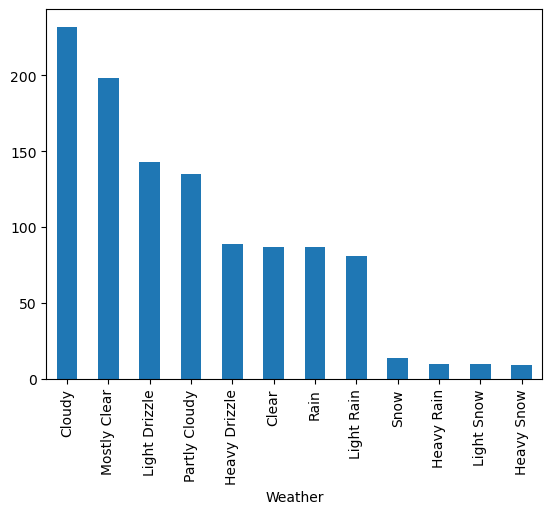

In [91]:
# plotting weather across days
df_DailyWeather['Weather'].value_counts().plot(kind='bar')


<Axes: xlabel='Weather'>

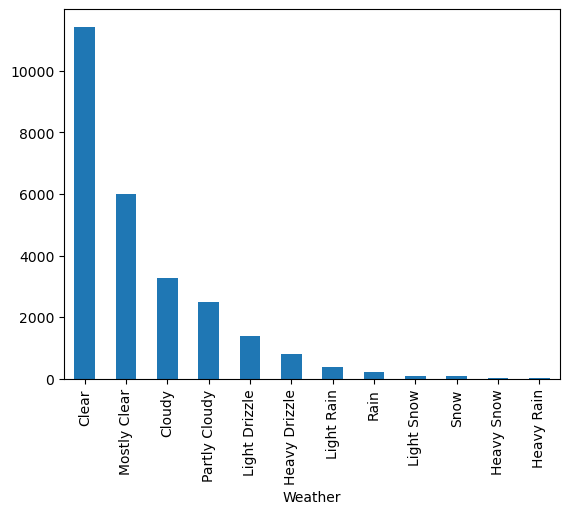

In [92]:
# plotting weather across hours

df_HourlyWeather['Weather'].value_counts().plot(kind='bar')

In [93]:
df_DailyWeather.head()

,Date,Year,Quarter,Month,Day,Weekend,Casual,Member,Total Rides,"Avg. ""Feels like"" (°C)",Avg. Temperature (°C),WMO Code,Weather,Max Wind (km/h)
0,2021-01-01,2021,2021Q1,January,Friday,Weekday,371,590,961,-0.9,2.3,63,Rain,10.6
1,2021-01-02,2021,2021Q1,January,Saturday,Weekend,2874,2844,5718,4.8,7.6,61,Light Rain,19.1
2,2021-01-03,2021,2021Q1,January,Sunday,Weekend,495,1133,1628,0.9,3.9,63,Rain,13.0
3,2021-01-04,2021,2021Q1,January,Monday,Weekday,907,2074,2981,1.0,4.1,3,Cloudy,13.3
4,2021-01-05,2021,2021Q1,January,Tuesday,Weekday,1057,2004,3061,1.4,4.0,51,Light Drizzle,9.2


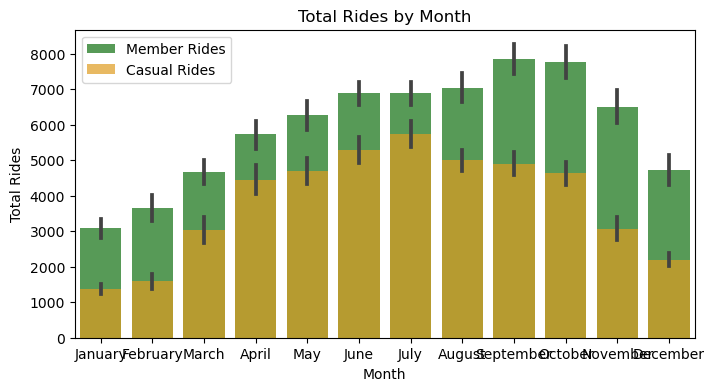

In [94]:
# plotting rides per month
plt.figure(figsize=(8, 4))

sns.barplot(data=df_DailyWeather, x="Month", y="Member", color="green", label="Member Rides", alpha=0.7)
sns.barplot(data=df_DailyWeather, x="Month", y="Casual", color="orange", label="Casual Rides", alpha=0.7)

plt.ylabel("Total Rides")
plt.xlabel("Month")
plt.title("Total Rides by Month")
plt.legend()

In [95]:
df_stationLoc['NAME'].value_counts()

NAME
14th St & Rhode Island Ave NW        1
New Hampshire & Gallatin St NW       1
21st St & Pennsylvania Ave NW        1
Amherst Ave & Elkins St              1
Westbranch Dr & Maitland St          1
                                    ..
King St & W Braddock Rd              1
10th & H St NE                       1
Riggs Rd & East West Hwy             1
10th St & Rhode Island Ave NE        1
Reston Pkwy & Bennington Woods Rd    1
Name: count, Length: 765, dtype: int64

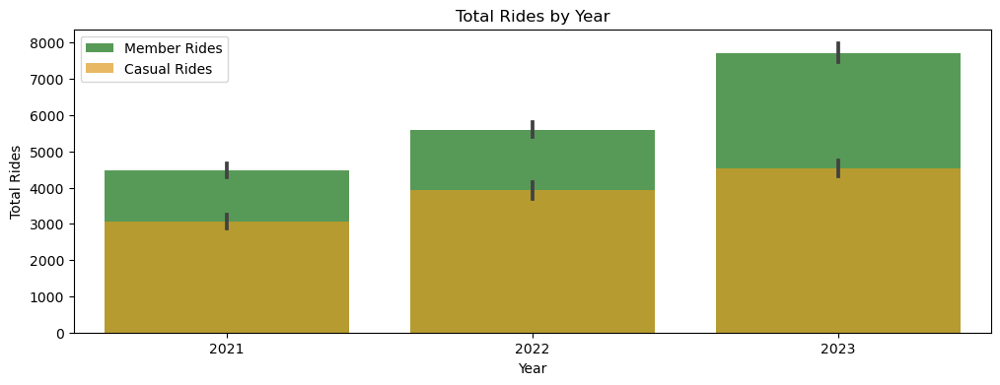

In [96]:
# plotting rides per year
plt.figure(figsize=(12, 4))

sns.barplot(data=df_DailyWeather, x="Year", y="Member", color="green", label="Member Rides", alpha=0.7)
sns.barplot(data=df_DailyWeather, x="Year", y="Casual", color="orange", label="Casual Rides", alpha=0.7)

plt.ylabel("Total Rides")
plt.xlabel("Year")
plt.title("Total Rides by Year")
plt.legend()

In [97]:
df_Full.head()

,Ride ID,Bike Type,Start Time,End Time,Start Station,Start Station ID,End Station,End Station ID,Start Lat,Start Lng,End Lat,End Lng,Rider Type,Duration
0,5CB9DFCECF79AF84,classic_bike,2021-01-01 00:08:33,2021-01-01 00:33:53,Maine Ave & 9th St SW,31646.0,Rosslyn Metro / Wilson Blvd & Ft Myer Dr,31015.0,38.880440,-77.025236,38.894600,-77.072305,member,0 days 00:25:20
1,629E059504606547,electric_bike,2021-01-01 00:13:43,2021-01-01 00:29:34,10th & U St NW,31111.0,Parked in Street,0,38.917193,-77.025894,38.960000,-77.020000,casual,0 days 00:15:51
2,E74069873161EE33,electric_bike,2021-01-01 00:14:32,2021-01-01 00:28:45,17th & Corcoran St NW,31214.0,14th & Belmont St NW,31119.0,38.912138,-77.038568,38.920870,-77.031691,member,0 days 00:14:13
3,91F95E512CABC46A,classic_bike,2021-01-01 00:15:45,2021-01-01 00:21:20,Wilson Blvd. & N. Vermont St.,31926.0,Wilson Blvd. & N. Vermont St.,31926.0,38.879477,-77.114563,38.879477,-77.114563,member,0 days 00:05:35
4,DA46A05139C0EA2F,classic_bike,2021-01-01 00:17:46,2021-01-01 00:21:00,11th & Park Rd NW,31651.0,14th & Newton St NW,31649.0,38.931322,-77.028247,38.931991,-77.032956,member,0 days 00:03:14


In [98]:
df_DailyWeather.head()

,Date,Year,Quarter,Month,Day,Weekend,Casual,Member,Total Rides,"Avg. ""Feels like"" (°C)",Avg. Temperature (°C),WMO Code,Weather,Max Wind (km/h)
0,2021-01-01,2021,2021Q1,January,Friday,Weekday,371,590,961,-0.9,2.3,63,Rain,10.6
1,2021-01-02,2021,2021Q1,January,Saturday,Weekend,2874,2844,5718,4.8,7.6,61,Light Rain,19.1
2,2021-01-03,2021,2021Q1,January,Sunday,Weekend,495,1133,1628,0.9,3.9,63,Rain,13.0
3,2021-01-04,2021,2021Q1,January,Monday,Weekday,907,2074,2981,1.0,4.1,3,Cloudy,13.3
4,2021-01-05,2021,2021Q1,January,Tuesday,Weekday,1057,2004,3061,1.4,4.0,51,Light Drizzle,9.2


In [99]:
daily_2021 = df_DailyWeather[df_DailyWeather['Year'] == 2021]
daily_2022 = df_DailyWeather[df_DailyWeather['Year'] == 2022]
daily_2023 = df_DailyWeather[df_DailyWeather['Year'] == 2023]

In [100]:
print(daily_2021['Total Rides'].sum())
print(daily_2022['Total Rides'].sum())
print(daily_2023['Total Rides'].sum())

2749881
3476782
4467334


Text(0.5, 1.0, 'Avg. Bike Rides p/day')

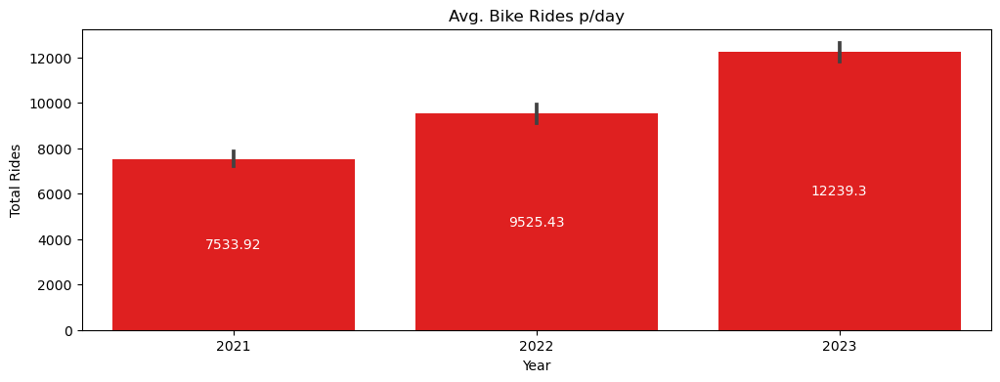

In [101]:
plt.figure(figsize=(12, 4))

ax=sns.barplot(data=df_DailyWeather, x="Year", y='Total Rides', color='red')
ax.bar_label(ax.containers[0], fontsize=10, label_type='center', color='white')
plt.ticklabel_format(style='plain', axis='y')

plt.title(label='Avg. Bike Rides p/day')

Text(0.5, 1.0, 'Total Rides p/year')

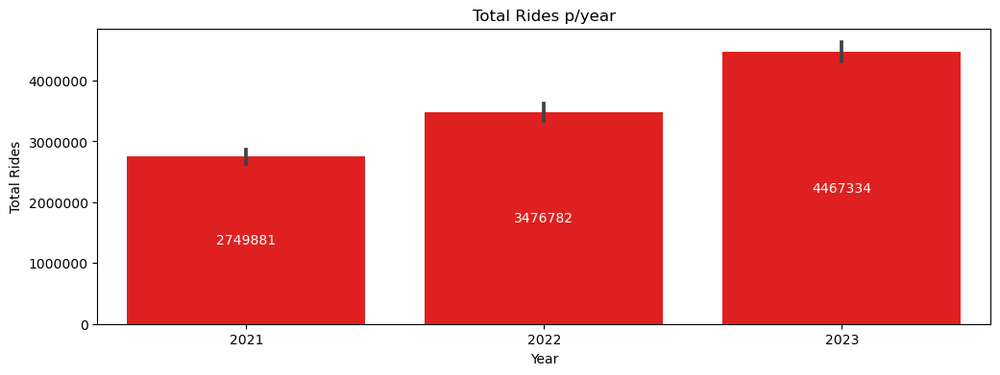

In [102]:
# Bike use across years

plt.figure(figsize=(12, 4))

ax=sns.barplot(data=df_DailyWeather, x="Year", y='Total Rides', color='red', estimator='sum',)
ax.bar_label(ax.containers[0], fontsize=10, label_type='center', color='white',  fmt = '%d')
plt.ticklabel_format(style='plain', axis='y')

plt.title(label='Total Rides p/year')


In [103]:
df_stations['NAME'].value_counts().sum()

765

In [104]:
df_Full['Start Station'].unique().value_counts().sum()

860

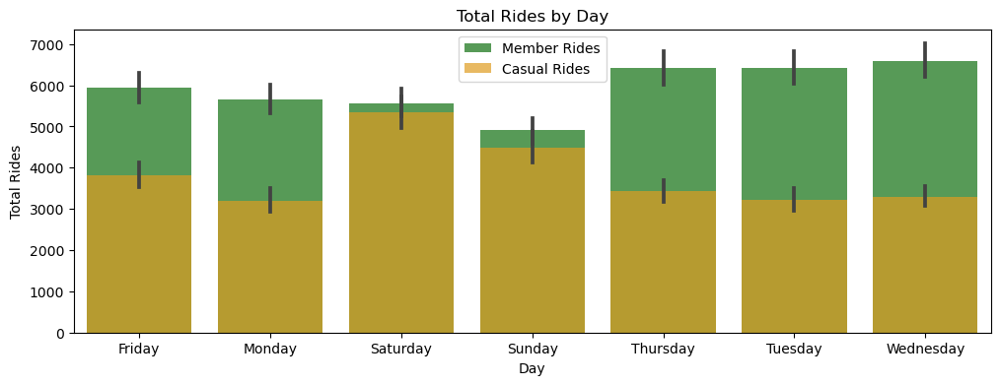

In [105]:
# plotting use per day
plt.figure(figsize=(12, 4))

sns.barplot(data=df_DailyWeather, x="Day", y="Member", color="green", label="Member Rides", alpha=0.7)
sns.barplot(data=df_DailyWeather, x="Day", y="Casual", color="orange", label="Casual Rides", alpha=0.7)

plt.ylabel("Total Rides")
plt.xlabel("Day")
plt.title("Total Rides by Day")
plt.legend()

Text(0.5, 1.0, 'Bike use across the day')

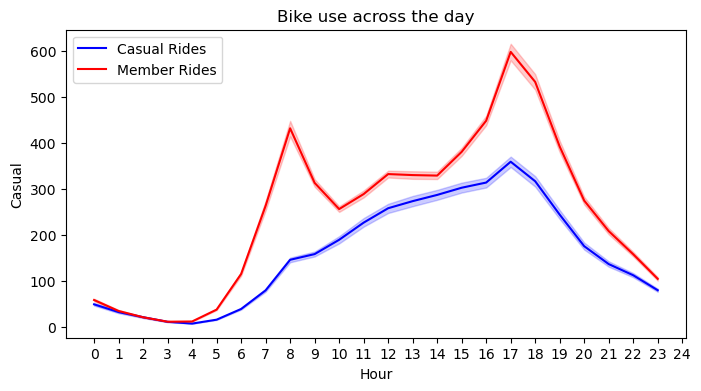

In [106]:

# plotting the use per hour across the day
df_HourlyWeather['Hour'] = df_HourlyWeather['Datetime'].dt.hour
plt.figure(figsize=(8,4))
sns.lineplot(df_HourlyWeather, x='Hour', y='Casual', label="Casual Rides", color='blue')
sns.lineplot(df_HourlyWeather, x='Hour', y='Member', label="Member Rides", color='red')
plt.xticks(range(25))
plt.legend()
plt.title('Bike use across the day')



<Axes: xlabel='Month', ylabel='Total Rides'>

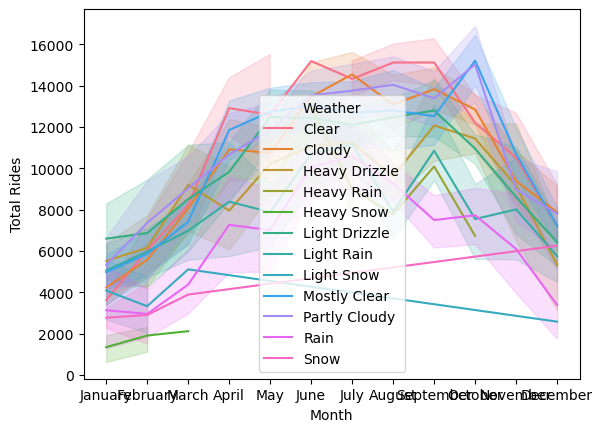

In [107]:
# data
sns.lineplot(df_DailyWeather, x='Month', y='Total Rides', hue='Weather')

Text(0.5, 1.0, 'LinePlot of Bike use p/Month')

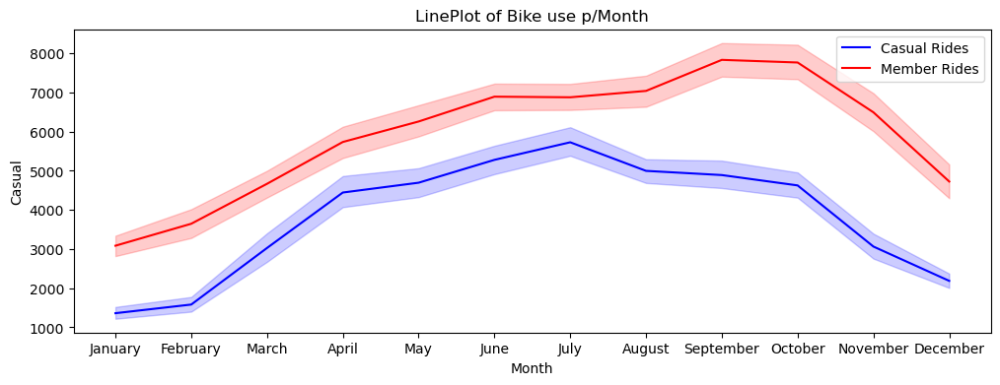

In [108]:
# plotting the use per hour across the day
plt.figure(figsize=(12,4))
sns.lineplot(df_DailyWeather, x='Month', y='Casual', label="Casual Rides", color='blue')
sns.lineplot(df_DailyWeather, x='Month', y='Member', label="Member Rides", color='red')
plt.legend()
plt.title('LinePlot of Bike use p/Month')

In [109]:
df_DailyWeather.head()

,Date,Year,Quarter,Month,Day,Weekend,Casual,Member,Total Rides,"Avg. ""Feels like"" (°C)",Avg. Temperature (°C),WMO Code,Weather,Max Wind (km/h)
0,2021-01-01,2021,2021Q1,January,Friday,Weekday,371,590,961,-0.9,2.3,63,Rain,10.6
1,2021-01-02,2021,2021Q1,January,Saturday,Weekend,2874,2844,5718,4.8,7.6,61,Light Rain,19.1
2,2021-01-03,2021,2021Q1,January,Sunday,Weekend,495,1133,1628,0.9,3.9,63,Rain,13.0
3,2021-01-04,2021,2021Q1,January,Monday,Weekday,907,2074,2981,1.0,4.1,3,Cloudy,13.3
4,2021-01-05,2021,2021Q1,January,Tuesday,Weekday,1057,2004,3061,1.4,4.0,51,Light Drizzle,9.2


Text(0.5, 1.0, 'Bike use across the day')

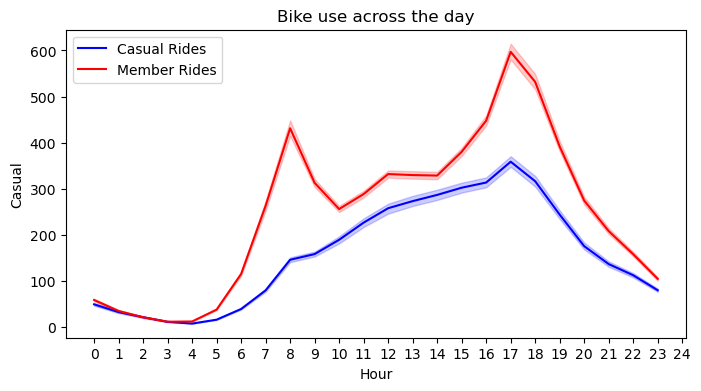

In [110]:
# plotting the use per hour across the day
df_HourlyWeather['Hour'] = df_HourlyWeather['Datetime'].dt.hour
plt.figure(figsize=(8,4))
sns.lineplot(df_HourlyWeather, x='Hour', y='Casual', label="Casual Rides", color='blue')
sns.lineplot(df_HourlyWeather, x='Hour', y='Member', label="Member Rides", color='red')
plt.xticks(range(25))
plt.legend()
plt.title('Bike use across the day')

In [111]:
df_stations.sort_values(by='CAPACITY', ascending=False).head(10)

,NAME,STATION_ID,NUM_EBIKES_AVAILABLE,CAPACITY,LATITUDE,LONGITUDE
643,Columbus Circle / Union Station,0824d0c6-1f3f-11e7-bf6b-3863bb334450,2,55,38.896960,-77.004930
475,USDA / 12th & C St SW,08249b7f-1f3f-11e7-bf6b-3863bb334450,2,47,38.886277,-77.028242
393,10th St & Constitution Ave NW,08249dad-1f3f-11e7-bf6b-3863bb334450,4,47,38.893028,-77.026013
233,Massachusetts Ave & Dupont Circle NW,0824920a-1f3f-11e7-bf6b-3863bb334450,1,45,38.910100,-77.044400
415,4th & C St SW,08250371-1f3f-11e7-bf6b-3863bb334450,5,39,38.886372,-77.017701
316,11th & Kenyon St NW,08247522-1f3f-11e7-bf6b-3863bb334450,0,39,38.929464,-77.027822
488,1st & N St SE,082484cf-1f3f-11e7-bf6b-3863bb334450,3,39,38.875023,-77.005754
750,16th & K St NW/BLM Plaza,1923638474906011698,3,39,38.902677,-77.035866
64,Metro Center / 12th & G St NW,0824c604-1f3f-11e7-bf6b-3863bb334450,14,39,38.898326,-77.027959
131,17th & K St NW / Farragut Square,0824c80d-1f3f-11e7-bf6b-3863bb334450,11,39,38.902061,-77.038322


In [112]:
df_stations.nlargest(20,'CAPACITY')

,NAME,STATION_ID,NUM_EBIKES_AVAILABLE,CAPACITY,LATITUDE,LONGITUDE
643,Columbus Circle / Union Station,0824d0c6-1f3f-11e7-bf6b-3863bb334450,2,55,38.896960,-77.004930
393,10th St & Constitution Ave NW,08249dad-1f3f-11e7-bf6b-3863bb334450,4,47,38.893028,-77.026013
475,USDA / 12th & C St SW,08249b7f-1f3f-11e7-bf6b-3863bb334450,2,47,38.886277,-77.028242
233,Massachusetts Ave & Dupont Circle NW,0824920a-1f3f-11e7-bf6b-3863bb334450,1,45,38.910100,-77.044400
64,Metro Center / 12th & G St NW,0824c604-1f3f-11e7-bf6b-3863bb334450,14,39,38.898326,-77.027959
131,17th & K St NW / Farragut Square,0824c80d-1f3f-11e7-bf6b-3863bb334450,11,39,38.902061,-77.038322
316,11th & Kenyon St NW,08247522-1f3f-11e7-bf6b-3863bb334450,0,39,38.929464,-77.027822
324,1st & M St SE,5f71434d-dc5c-45ff-8219-708a3d9a0691,2,39,38.876893,-77.006072
415,4th & C St SW,08250371-1f3f-11e7-bf6b-3863bb334450,5,39,38.886372,-77.017701
488,1st & N St SE,082484cf-1f3f-11e7-bf6b-3863bb334450,3,39,38.875023,-77.005754


In [113]:
df_CBS = df_Full.drop(columns=['Ride ID', 'Start Station ID', 'End Station ID'])

In [114]:
df_CBS[df_CBS['Start Station']=='Parked in Street'].value_counts()

Bike Type      Start Time           End Time             Start Station     End Station                     Start Lat  Start Lng  End Lat    End Lng     Rider Type  Duration       
electric_bike  2021-10-24 16:20:21  2021-10-24 16:33:06  Parked in Street  Parked in Street                38.92      -77.04     38.900000  -77.020000  casual      0 days 00:12:45    2
               2023-11-10 18:36:47  2023-11-11 02:36:42  Parked in Street  Parked in Street                38.96      -77.03     38.960000  -77.030000  casual      0 days 07:59:55    2
               2023-07-22 10:37:31  2023-07-22 10:41:17  Parked in Street  3rd St & Riggs Rd NE            38.96      -77.01     38.957463  -77.002239  member      0 days 00:03:46    1
               2023-07-22 10:31:57  2023-07-22 10:39:35  Parked in Street  C & O Canal & Wisconsin Ave NW  38.93      -77.07     38.903750  -77.062690  member      0 days 00:07:38    1
               2023-07-22 10:32:00  2023-07-22 10:52:47  Parked in Street  Parke

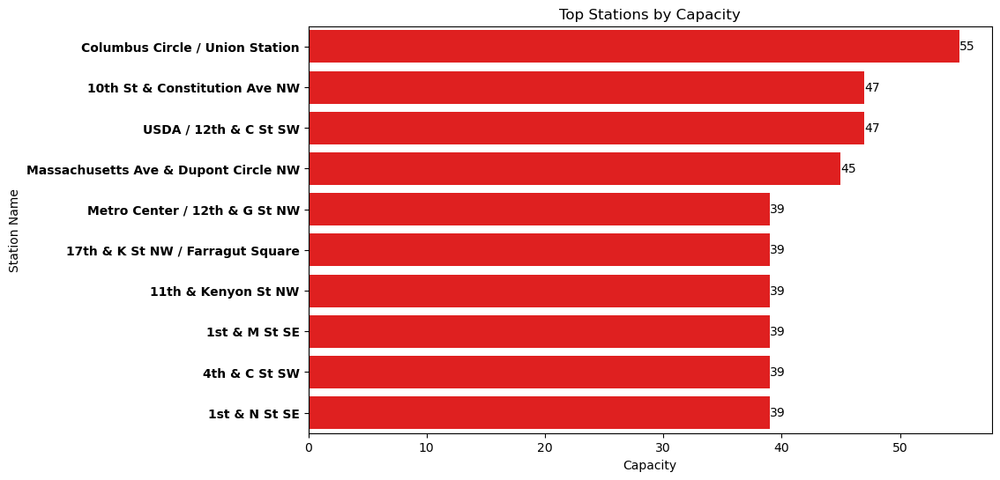

In [115]:
# plot of the top stations by capacity

top20capacity = df_stations.nlargest(10,'CAPACITY')

plt.figure(figsize=(10, 6))

ax = sns.barplot(x='CAPACITY', y='NAME', data=top20capacity, color="red")

ax.bar_label(ax.containers[0], fontsize=10)
plt.title('Top Stations by Capacity')
plt.xlabel('Capacity')
plt.ylabel('Station Name')
plt.yticks(weight = 'bold')

plt.show()

In [116]:
# top 10 starting station for bike rides
df_Full['Start Station'].value_counts().head(10)

Start Station
Parked in Street                   742766
New Hampshire Ave & T St NW        104815
Columbus Circle / Union Station    102847
15th & P St NW                      98013
Lincoln Memorial                    97827
Jefferson Dr & 14th St SW           89369
1st & M St NE                       88887
4th St & Madison Dr NW              84899
5th & K St NW                       78519
14th & V St NW                      78479
Name: count, dtype: int64

In [117]:
# top 10 ending station for bike rides
df_Full['End Station'].value_counts().head(10)

End Station
Parked in Street                        794517
Columbus Circle / Union Station         104589
New Hampshire Ave & T St NW             103221
15th & P St NW                           98855
Lincoln Memorial                         96032
Jefferson Dr & 14th St SW                92158
1st & M St NE                            89838
4th St & Madison Dr NW                   83684
Massachusetts Ave & Dupont Circle NW     80572
5th & K St NW                            79702
Name: count, dtype: int64

In [118]:
df_Full.dtypes

Ride ID                      object
Bike Type                  category
Start Time           datetime64[ns]
End Time             datetime64[ns]
Start Station              category
Start Station ID             object
End Station                category
End Station ID               object
Start Lat                   float64
Start Lng                   float64
End Lat                     float64
End Lng                     float64
Rider Type                 category
Duration            timedelta64[ns]
dtype: object

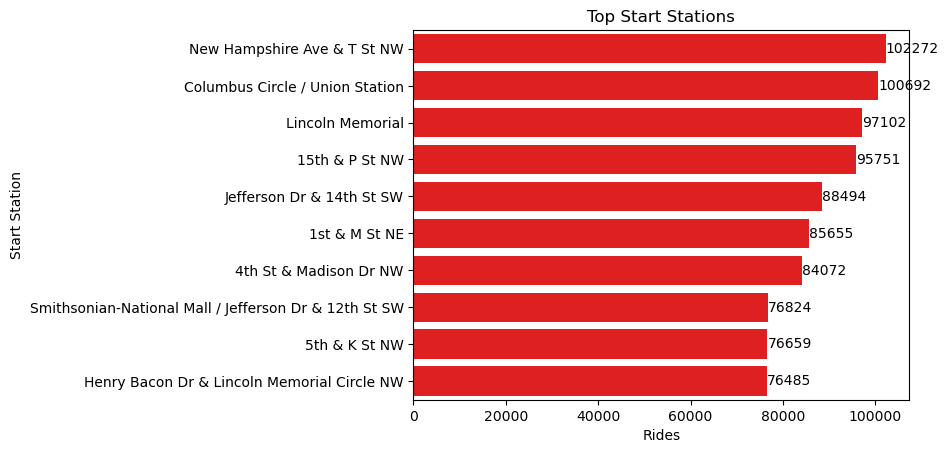

In [119]:
# plot → top Start stations (without street-parked bikes)

station_to_exclude = 'Parked in Street'
df_NoStreetParked = df_Full[(df_Full['Start Station'] != station_to_exclude) & (df_Full['End Station'] != station_to_exclude)]

ax = sns.countplot(y='Start Station', data=df_NoStreetParked, order=df_NoStreetParked['Start Station'].value_counts().head(10).index, color="red")
ax.bar_label(ax.containers[0], fontsize=10)
plt.title('Top Start Stations')
plt.xlabel('Rides')
plt.ylabel('Start Station')
plt.show()

In [120]:
df_Full.head()

,Ride ID,Bike Type,Start Time,End Time,Start Station,Start Station ID,End Station,End Station ID,Start Lat,Start Lng,End Lat,End Lng,Rider Type,Duration
0,5CB9DFCECF79AF84,classic_bike,2021-01-01 00:08:33,2021-01-01 00:33:53,Maine Ave & 9th St SW,31646.0,Rosslyn Metro / Wilson Blvd & Ft Myer Dr,31015.0,38.880440,-77.025236,38.894600,-77.072305,member,0 days 00:25:20
1,629E059504606547,electric_bike,2021-01-01 00:13:43,2021-01-01 00:29:34,10th & U St NW,31111.0,Parked in Street,0,38.917193,-77.025894,38.960000,-77.020000,casual,0 days 00:15:51
2,E74069873161EE33,electric_bike,2021-01-01 00:14:32,2021-01-01 00:28:45,17th & Corcoran St NW,31214.0,14th & Belmont St NW,31119.0,38.912138,-77.038568,38.920870,-77.031691,member,0 days 00:14:13
3,91F95E512CABC46A,classic_bike,2021-01-01 00:15:45,2021-01-01 00:21:20,Wilson Blvd. & N. Vermont St.,31926.0,Wilson Blvd. & N. Vermont St.,31926.0,38.879477,-77.114563,38.879477,-77.114563,member,0 days 00:05:35
4,DA46A05139C0EA2F,classic_bike,2021-01-01 00:17:46,2021-01-01 00:21:00,11th & Park Rd NW,31651.0,14th & Newton St NW,31649.0,38.931322,-77.028247,38.931991,-77.032956,member,0 days 00:03:14


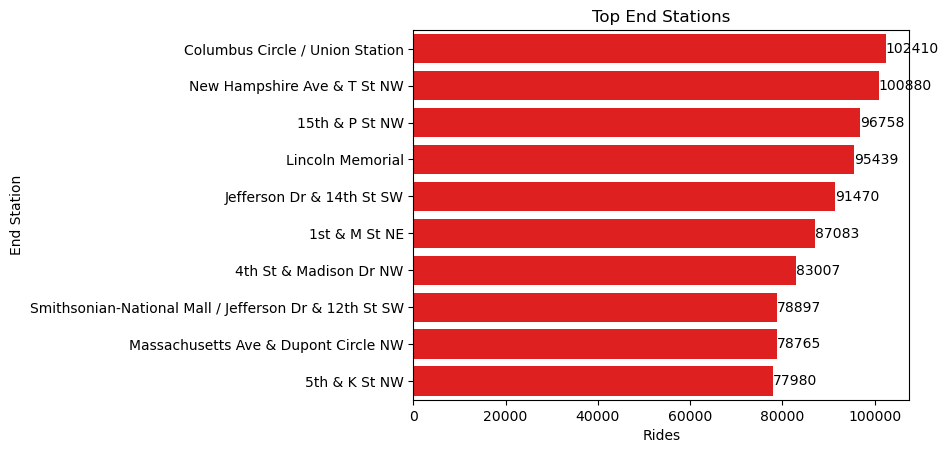

In [121]:
# plot → top End stations (without street-parked bikes)

ax = sns.countplot(y='End Station', data=df_NoStreetParked, order=df_NoStreetParked['End Station'].value_counts().head(10).index, color="red")

ax.bar_label(ax.containers[0], fontsize=10)
plt.title('Top End Stations')
plt.xlabel('Rides')
plt.ylabel('End Station')
plt.show()

In [122]:
df_Full.dtypes

Ride ID                      object
Bike Type                  category
Start Time           datetime64[ns]
End Time             datetime64[ns]
Start Station              category
Start Station ID             object
End Station                category
End Station ID               object
Start Lat                   float64
Start Lng                   float64
End Lat                     float64
End Lng                     float64
Rider Type                 category
Duration            timedelta64[ns]
dtype: object

In [123]:
df_NoStreetParked[(df_NoStreetParked['Start Station']== 'Lincoln Memorial') & (df_NoStreetParked['End Station']== 'Lincoln Memorial')]



,Ride ID,Bike Type,Start Time,End Time,Start Station,Start Station ID,End Station,End Station ID,Start Lat,Start Lng,End Lat,End Lng,Rider Type,Duration
1525,6F7C81AC80607D04,docked_bike,2021-01-02 10:46:15,2021-01-02 10:46:29,Lincoln Memorial,31258.0,Lincoln Memorial,31258.0,38.888255,-77.049437,38.888255,-77.049437,casual,0 days 00:00:14
1712,F0312094A37B199F,docked_bike,2021-01-02 11:21:21,2021-01-02 11:57:40,Lincoln Memorial,31258.0,Lincoln Memorial,31258.0,38.888255,-77.049437,38.888255,-77.049437,casual,0 days 00:36:19
2032,806AD5DE09AD86D3,docked_bike,2021-01-02 12:00:57,2021-01-02 12:01:09,Lincoln Memorial,31258.0,Lincoln Memorial,31258.0,38.888255,-77.049437,38.888255,-77.049437,casual,0 days 00:00:12
2879,6F1BF779BC54749D,classic_bike,2021-01-02 13:17:28,2021-01-02 13:31:26,Lincoln Memorial,31258.0,Lincoln Memorial,31258.0,38.888255,-77.049436,38.888255,-77.049436,casual,0 days 00:13:58
2891,08D4C7FFDFDCE519,classic_bike,2021-01-02 13:18:44,2021-01-02 13:31:33,Lincoln Memorial,31258.0,Lincoln Memorial,31258.0,38.888255,-77.049436,38.888255,-77.049436,casual,0 days 00:12:49
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10691702,EA343A5721A8173B,classic_bike,2023-12-31 16:45:30,2023-12-31 16:49:54,Lincoln Memorial,31258.0,Lincoln Memorial,31258.0,38.888255,-77.049436,38.888255,-77.049436,casual,0 days 00:04:24
10691917,C8877B23E240581E,classic_bike,2023-12-31 17:07:25,2023-12-31 17:09:22,Lincoln Memorial,31258.0,Lincoln Memorial,31258.0,38.888255,-77.049436,38.888255,-77.049436,casual,0 days 00:01:57
10692823,23E7F15B378B5ECD,electric_bike,2023-12-31 19:18:28,2023-12-31 21:16:11,Lincoln Memorial,31258.0,Lincoln Memorial,31258.0,38.888250,-77.049474,38.888255,-77.049436,casual,0 days 01:57:43
10692874,CC73E961AB0A276B,electric_bike,2023-12-31 19:25:17,2023-12-31 21:15:59,Lincoln Memorial,31258.0,Lincoln Memorial,31258.0,38.888283,-77.049447,38.888255,-77.049436,casual,0 days 01:50:42


C:\Users\EWF\AppData\Local\Temp\ipykernel_18364\616705241.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_NoStreetParked['Start Station'] = df_NoStreetParked['Start Station'].astype(str)
C:\Users\EWF\AppData\Local\Temp\ipykernel_18364\616705241.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_NoStreetParked['End Station'] = df_NoStreetParked['End Station'].astype(str)
C:\Users\EWF\AppData\Local\Temp\ipykernel_18364\616705241.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy o

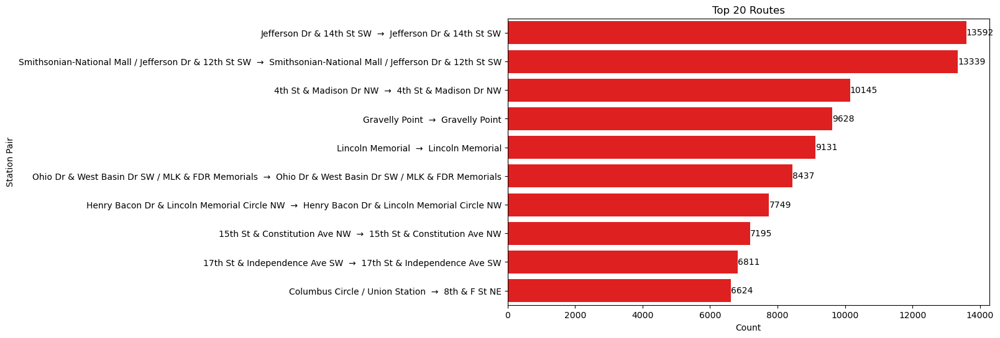

In [124]:
# plot → top bike routes 
df_NoStreetParked['Start Station'] = df_NoStreetParked['Start Station'].astype(str)
df_NoStreetParked['End Station'] = df_NoStreetParked['End Station'].astype(str)

df_NoStreetParked['Station Pair'] = df_NoStreetParked['Start Station'] + '  →  ' + df_NoStreetParked['End Station']
top_20_pairs = df_NoStreetParked['Station Pair'].value_counts().head(10)


plt.figure(figsize=(10, 6))
ax = sns.barplot(x=top_20_pairs.values, y=top_20_pairs.index, color="red")

ax.bar_label(ax.containers[0], fontsize=10)
plt.title('Top 20 Routes')
plt.xlabel('Count')
plt.ylabel('Station Pair')
plt.show()


In [125]:
df_NoStreetParked['End Station'].value_counts().head(10)

End Station
Columbus Circle / Union Station                          102410
New Hampshire Ave & T St NW                              100880
15th & P St NW                                            96758
Lincoln Memorial                                          95439
Jefferson Dr & 14th St SW                                 91470
1st & M St NE                                             87083
4th St & Madison Dr NW                                    83007
Smithsonian-National Mall / Jefferson Dr & 12th St SW     78897
Massachusetts Ave & Dupont Circle NW                      78765
5th & K St NW                                             77980
Name: count, dtype: int64

In [126]:
df_NoStreetParked['Start Station'].value_counts().head(10)

Start Station
New Hampshire Ave & T St NW                              102272
Columbus Circle / Union Station                          100692
Lincoln Memorial                                          97102
15th & P St NW                                            95751
Jefferson Dr & 14th St SW                                 88494
1st & M St NE                                             85655
4th St & Madison Dr NW                                    84072
Smithsonian-National Mall / Jefferson Dr & 12th St SW     76824
5th & K St NW                                             76659
Henry Bacon Dr & Lincoln Memorial Circle NW               76485
Name: count, dtype: int64

In [127]:
df_NoStreetParked['Station Pair'].value_counts().head(10)

Station Pair
Jefferson Dr & 14th St SW  →  Jefferson Dr & 14th St SW                                                            13592
Smithsonian-National Mall / Jefferson Dr & 12th St SW  →  Smithsonian-National Mall / Jefferson Dr & 12th St SW    13339
4th St & Madison Dr NW  →  4th St & Madison Dr NW                                                                  10145
Gravelly Point  →  Gravelly Point                                                                                   9628
Lincoln Memorial  →  Lincoln Memorial                                                                               9131
Ohio Dr & West Basin Dr SW / MLK & FDR Memorials  →  Ohio Dr & West Basin Dr SW / MLK & FDR Memorials               8437
Henry Bacon Dr & Lincoln Memorial Circle NW  →  Henry Bacon Dr & Lincoln Memorial Circle NW                         7749
15th St & Constitution Ave NW  →  15th St & Constitution Ave NW                                                     7195
17th St & Independe

C:\Users\EWF\AppData\Local\Temp\ipykernel_18364\4151848310.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_NoStreetParked['Start Hour'] = df_NoStreetParked['Start Time'].dt.hour # inserting an hor column based on the timestamp of the Start


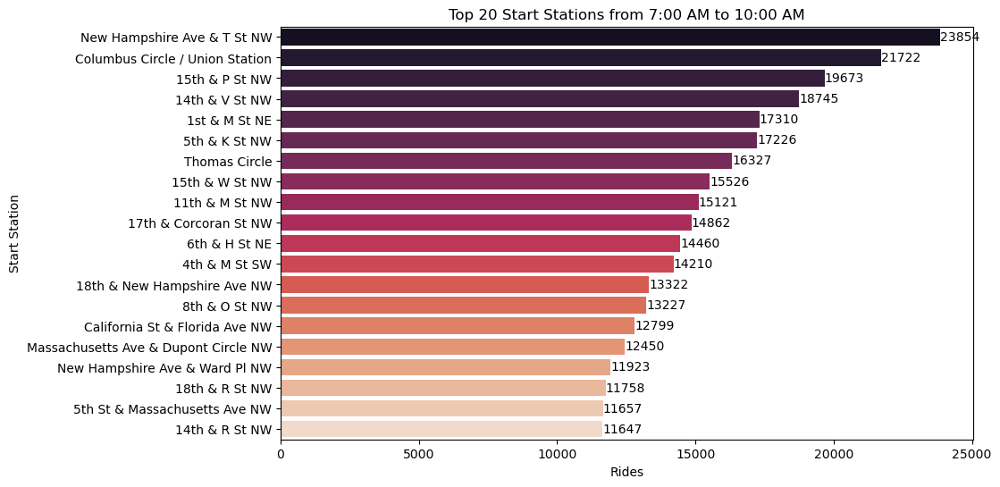

In [128]:
# plot → top start stations during morning  

morning_start = pd.to_datetime('07:00:00').time()
morning_end = pd.to_datetime('10:00:00').time()

df_NoStreetParked['Start Hour'] = df_NoStreetParked['Start Time'].dt.hour # inserting an hor column based on the timestamp of the Start 

filtered_df = df_NoStreetParked[(df_NoStreetParked['Start Hour'] >= morning_start.hour) & (df_NoStreetParked['Start Hour'] <= morning_end.hour)] # filtering the data  

top20MorningStartStations = filtered_df['Start Station'].value_counts().head(20)

plt.figure(figsize=(10, 6))
ax = sns.barplot(x=top20MorningStartStations.values, y=top20MorningStartStations.index, palette="rocket")

ax.bar_label(ax.containers[0], fontsize=10)
plt.title('Top 20 Start Stations from 7:00 AM to 10:00 AM')
plt.xlabel('Rides')
plt.ylabel('Start Station')
plt.show()

C:\Users\EWF\AppData\Local\Temp\ipykernel_18364\2212290873.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_NoStreetParked['End Hour'] = df_NoStreetParked['End Time'].dt.hour # inserting an hor column based on the timestamp of the Start


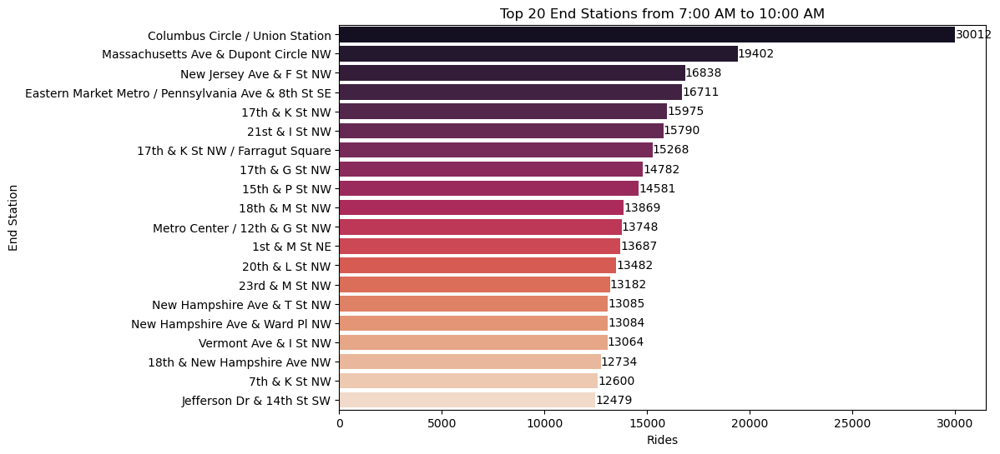

In [129]:
# plot → top end stations during morning  

morning_start = pd.to_datetime('07:00:00').time()
morning_end = pd.to_datetime('10:00:00').time()

df_NoStreetParked['End Hour'] = df_NoStreetParked['End Time'].dt.hour # inserting an hor column based on the timestamp of the Start 

filtered_df = df_NoStreetParked[(df_NoStreetParked['End Hour'] >= morning_start.hour) & (df_NoStreetParked['End Hour'] <= morning_end.hour)] # filtering the data  

top20MorningEndStations = filtered_df['End Station'].value_counts().head(20)

plt.figure(figsize=(10, 6))
ax = sns.barplot(x=top20MorningEndStations.values, y=top20MorningEndStations.index, palette="rocket")

ax.bar_label(ax.containers[0], fontsize=10)
plt.title('Top 20 End Stations from 7:00 AM to 10:00 AM')
plt.xlabel('Rides')
plt.ylabel('End Station')
plt.show()

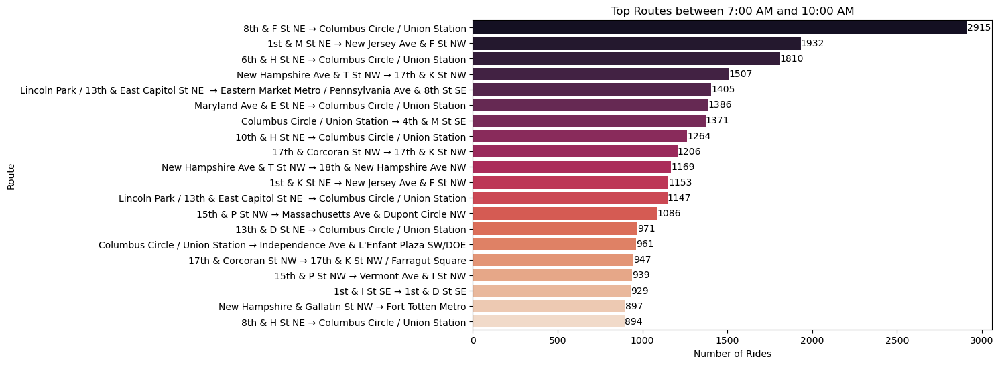

In [130]:
# top routes in the morning 

# Filter the DataFrame to include only rows where either start time or end time falls within the specified time range
filtered_df = df_NoStreetParked[((df_NoStreetParked['Start Time'].dt.time >= morning_start) & (df_NoStreetParked['Start Time'].dt.time <= morning_end)) | 
                 ((df_NoStreetParked['End Time'].dt.time >= morning_start) & (df_NoStreetParked['End Time'].dt.time <= morning_end))]

# Count the occurrences of each unique combination of 'Start Station' and 'End Station'
route_counts = filtered_df.groupby(['Start Station', 'End Station']).size().reset_index(name='Count')

# Get the top routes
top_routes = route_counts.sort_values(by='Count', ascending=False).head(20)

# Plotting
plt.figure(figsize=(10, 6))

ax = sns.barplot(x='Count', y=top_routes['Start Station'] + ' → ' + top_routes['End Station'], data=top_routes, palette="rocket")

ax.bar_label(ax.containers[0], fontsize=10)
plt.title('Top Routes between 7:00 AM and 10:00 AM')
plt.xlabel('Number of Rides')
plt.ylabel('Route')

plt.show()

**Maps with Folium**

In [131]:
min_lng, max_lng = -77.123346, -76.909647
min_lat, max_lat = 38.790419, 38.995872

mymap = folium.Map(tiles='CartoDB Voyager', 
    location=[38.9072, -77.0369], 
    zoom_start=12, 
    max_bounds=True, 
    min_zoom=10, 
    max_zoom=15, 
    min_lat=min_lat,
    max_lat=max_lat,
    min_lon=min_lng,
    max_lon=max_lng,
    control_scale=True)



In [132]:
# top 20 routes visualised in map

# set map display limits to prevent scrolling outside from area

min_lng, max_lng = -77.123346, -76.909647
min_lat, max_lat = 38.790419, 38.995872

# map creation and adding the desired parameters

mymap = folium.Map(tiles='CartoDB Voyager', 
    location=[38.9072, -77.0369], 
    zoom_start=12, 
    max_bounds=True, 
    min_zoom=10, 
    max_zoom=15, 
    min_lat=min_lat,
    max_lat=max_lat,
    min_lon=min_lng,
    max_lon=max_lng,
    control_scale=True)


# mapping out the top 20 routes by iterating through each
for index, row in top_routes.iterrows():
    # Get start and end station names
    start_station = row['Start Station']
    end_station = row['End Station']
    
    # Fetch corresponding rows from df_Full for start and end stations
    start_row = df_Full[df_Full['Start Station'] == start_station].iloc[0]
    end_row = df_Full[df_Full['End Station'] == end_station].iloc[0]
    
    # Get start and end coordinates
    start_coords = (start_row['Start Lat'], start_row['Start Lng'])
    end_coords = (end_row['End Lat'], end_row['End Lng'])

    # Generate a random color for the route
    route_color = "#{:06x}".format(random.randint(0, 0xFFFFFF))
    
    # Add an AntPath between start and end coordinates with the specified color
    folium.plugins.AntPath(locations=[start_coords, end_coords], color=route_color).add_to(mymap)

    # Add markers for start and end stations with their names, and color them differently
    folium.Marker(location=start_coords, popup=start_station, icon=folium.Icon(color='green')).add_to(mymap)
    folium.Marker(location=end_coords, popup=end_station, icon=folium.Icon(color='red')).add_to(mymap)

# map limits preventing scrolling from a set area

folium.CircleMarker([max_lat, min_lng], tooltip="Upper Left Limit").add_to(mymap)
folium.CircleMarker([min_lat, min_lng], tooltip="Lower Left Limit").add_to(mymap)
folium.CircleMarker([min_lat, max_lng], tooltip="Lower Right Limit").add_to(mymap)
folium.CircleMarker([max_lat, max_lng], tooltip="Upper Right Limit").add_to(mymap)

# adding layer control box and additional layers to the map

folium.LayerControl(
    name='Control Box'
).add_to(mymap)


# Display the map
mymap

In [133]:
# plotting bike stations across map with on/off togge in the Layer Control box 

m = folium.Map(location=[38.9072, -77.0369], zoom_start=12)
marker_layer = folium.FeatureGroup(name='Stations')
# Iterate through the stations
for index, row in df_stations.iterrows():
    # Add a CircleMarker for each station
    folium.Circle(
        location=[row['LATITUDE'], row['LONGITUDE']],
        radius=row['CAPACITY'],  # Use CAPACITY column to determine the size of the circle
        color='blue',
        fill=True,
        fill_color='blue',
        fill_opacity=0.6,
        popup=row['NAME'] + '<br>Capacity: ' + str(row['CAPACITY'])
    ).add_to(marker_layer)

marker_layer.add_to(m)

folium.LayerControl().add_to(m)


# Display the map
m

In [134]:
df_Full.head()

,Ride ID,Bike Type,Start Time,End Time,Start Station,Start Station ID,End Station,End Station ID,Start Lat,Start Lng,End Lat,End Lng,Rider Type,Duration
0,5CB9DFCECF79AF84,classic_bike,2021-01-01 00:08:33,2021-01-01 00:33:53,Maine Ave & 9th St SW,31646.0,Rosslyn Metro / Wilson Blvd & Ft Myer Dr,31015.0,38.880440,-77.025236,38.894600,-77.072305,member,0 days 00:25:20
1,629E059504606547,electric_bike,2021-01-01 00:13:43,2021-01-01 00:29:34,10th & U St NW,31111.0,Parked in Street,0,38.917193,-77.025894,38.960000,-77.020000,casual,0 days 00:15:51
2,E74069873161EE33,electric_bike,2021-01-01 00:14:32,2021-01-01 00:28:45,17th & Corcoran St NW,31214.0,14th & Belmont St NW,31119.0,38.912138,-77.038568,38.920870,-77.031691,member,0 days 00:14:13
3,91F95E512CABC46A,classic_bike,2021-01-01 00:15:45,2021-01-01 00:21:20,Wilson Blvd. & N. Vermont St.,31926.0,Wilson Blvd. & N. Vermont St.,31926.0,38.879477,-77.114563,38.879477,-77.114563,member,0 days 00:05:35
4,DA46A05139C0EA2F,classic_bike,2021-01-01 00:17:46,2021-01-01 00:21:00,11th & Park Rd NW,31651.0,14th & Newton St NW,31649.0,38.931322,-77.028247,38.931991,-77.032956,member,0 days 00:03:14


In [135]:
df_stationLoc.head()

,X,Y,NAME,STATION_TYPE,STATION_ID,STATION_STATUS,LAST_REPORTED,NUM_DOCKS_AVAILABLE,NUM_DOCKS_DISABLED,NUM_BIKES_AVAILABLE,...,EIGHTD_HAS_KEY_DISPENSER,CAPACITY,RENTAL_METHODS,REGION_ID,REGION_NAME,GIS_ID,LATITUDE,LONGITUDE,GIS_LAST_MOD_DTTM,OBJECTID
0,-77.032297,38.908604,14th St & Rhode Island Ave NW,classic,08247a21-1f3f-11e7-bf6b-3863bb334450,NaN,2024/03/19 15:05:19+00,26,0,4,...,NO,31,"KEY,CREDITCARD",42.0,DCA-CABI,NaN,38.908600,-77.032300,2024/03/19 15:07:27+00,169701679
1,-77.021551,38.947972,Kansas Ave & Sherman Cr NW,classic,c645ddde-0156-47ab-9616-3121f541a6f0,NaN,2024/03/19 15:05:19+00,5,0,14,...,NO,19,"KEY,CREDITCARD",42.0,DCA-CABI,NaN,38.947962,-77.021550,2024/03/19 15:07:27+00,169701680
2,-77.363099,38.955176,Town Center Pkwy & Sunset Hills Rd,classic,082653a6-1f3f-11e7-bf6b-3863bb334450,NaN,2024/03/19 15:05:18+00,7,0,3,...,NO,11,"KEY,CREDITCARD",104.0,DCA-CABI,NaN,38.955171,-77.363094,2024/03/19 15:07:27+00,169701681
3,-77.032953,38.931998,14th & Newton St NW,classic,e9030e46-31bf-4def-befb-2e685ad48180,NaN,2024/03/19 15:05:15+00,18,0,1,...,NO,19,"KEY,CREDITCARD",42.0,DCA-CABI,NaN,38.931991,-77.032956,2024/03/19 15:07:27+00,169701682
4,-77.016058,38.782642,Fleet St & Waterfront St,classic,d4e8307d-5fb2-4ece-a66a-1522b1ebf79c,NaN,2024/03/19 15:05:15+00,4,0,11,...,NO,15,"KEY,CREDITCARD",133.0,DCA-CABI,NaN,38.782633,-77.016059,2024/03/19 15:07:27+00,169701683


In [136]:
# plotting a heatmap of biking activity across top stations

df_Full.head()

,Ride ID,Bike Type,Start Time,End Time,Start Station,Start Station ID,End Station,End Station ID,Start Lat,Start Lng,End Lat,End Lng,Rider Type,Duration
0,5CB9DFCECF79AF84,classic_bike,2021-01-01 00:08:33,2021-01-01 00:33:53,Maine Ave & 9th St SW,31646.0,Rosslyn Metro / Wilson Blvd & Ft Myer Dr,31015.0,38.880440,-77.025236,38.894600,-77.072305,member,0 days 00:25:20
1,629E059504606547,electric_bike,2021-01-01 00:13:43,2021-01-01 00:29:34,10th & U St NW,31111.0,Parked in Street,0,38.917193,-77.025894,38.960000,-77.020000,casual,0 days 00:15:51
2,E74069873161EE33,electric_bike,2021-01-01 00:14:32,2021-01-01 00:28:45,17th & Corcoran St NW,31214.0,14th & Belmont St NW,31119.0,38.912138,-77.038568,38.920870,-77.031691,member,0 days 00:14:13
3,91F95E512CABC46A,classic_bike,2021-01-01 00:15:45,2021-01-01 00:21:20,Wilson Blvd. & N. Vermont St.,31926.0,Wilson Blvd. & N. Vermont St.,31926.0,38.879477,-77.114563,38.879477,-77.114563,member,0 days 00:05:35
4,DA46A05139C0EA2F,classic_bike,2021-01-01 00:17:46,2021-01-01 00:21:00,11th & Park Rd NW,31651.0,14th & Newton St NW,31649.0,38.931322,-77.028247,38.931991,-77.032956,member,0 days 00:03:14


In [137]:
df_Full.iloc[1].to_dict()

{'Ride ID': '629E059504606547',
 'Bike Type': 'electric_bike',
 'Start Time': Timestamp('2021-01-01 00:13:43'),
 'End Time': Timestamp('2021-01-01 00:29:34'),
 'Start Station': '10th & U St NW',
 'Start Station ID': 31111.0,
 'End Station': 'Parked in Street',
 'End Station ID': 0,
 'Start Lat': 38.917192666666665,
 'Start Lng': -77.02589416666666,
 'End Lat': 38.96,
 'End Lng': -77.02,
 'Rider Type': 'casual',
 'Duration': Timedelta('0 days 00:15:51')}

In [138]:
df_Full.info()

<class 'pandas.core.frame.DataFrame'>
Index: 10693985 entries, 0 to 10693996
Data columns (total 14 columns):
 #   Column            Dtype          
---  ------            -----          
 0   Ride ID           object         
 1   Bike Type         category       
 2   Start Time        datetime64[ns] 
 3   End Time          datetime64[ns] 
 4   Start Station     category       
 5   Start Station ID  object         
 6   End Station       category       
 7   End Station ID    object         
 8   Start Lat         float64        
 9   Start Lng         float64        
 10  End Lat           float64        
 11  End Lng           float64        
 12  Rider Type        category       
 13  Duration          timedelta64[ns]
dtypes: category(4), datetime64[ns](2), float64(4), object(3), timedelta64[ns](1)
memory usage: 1.2+ GB


In [139]:
# 1. Filter top 20 starting stations
top20_start_stations = df_Full['Start Station'].value_counts().nlargest(20).index
df_filtered = df_Full[df_Full['Start Station'].isin(top20_start_stations)]


In [140]:
# 2. Aggregate data on an hourly basis
df_filtered['Start Time'] = pd.to_datetime(df_filtered['Start Time'])
df_filtered['Hour'] = df_filtered['Start Time'].dt.floor('H')

C:\Users\EWF\AppData\Local\Temp\ipykernel_18364\1456887539.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Start Time'] = pd.to_datetime(df_filtered['Start Time'])
C:\Users\EWF\AppData\Local\Temp\ipykernel_18364\1456887539.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Hour'] = df_filtered['Start Time'].dt.floor('H')


In [141]:
# 3. Create HeatMap
heat_data = df_filtered[['Start Lat', 'Start Lng', 'Hour']].groupby(['Start Lat', 'Start Lng', 'Hour']).size().reset_index(name='count')
heatmap_data = heat_data[['Start Lat', 'Start Lng', 'count']].values.tolist()

In [142]:
# Create Folium Map
m = folium.Map(location=[df_filtered['Start Lat'].mean(), df_filtered['Start Lng'].mean()], zoom_start=12)

# Add HeatMap layer
HeatMap(heatmap_data, radius=10).add_to(m)

# Save the map to an HTML file
m.save("heatmap_with_time.html")

In [143]:
# display heatmap
m

### **Step 3** - ML Regression models  
1. Data Preprocessing
1. Linear regression 
1. Polynomial regression 
1. Further iterations   


In [144]:
df_HourlyWeather.head()

,Casual,Member,Total Rides,Humidity (%),Temperature (°C),WMO Code,Weather,Wind (km/h),Datetime,Hour
0,20,26,46,90,2.4,1,Mostly Clear,10.2,2021-01-01 00:00:00,0
1,23,23,46,88,1.8,1,Mostly Clear,10.0,2021-01-01 01:00:00,1
2,20,28,48,87,1.1,2,Partly Cloudy,10.1,2021-01-01 02:00:00,2
3,9,7,16,81,1.6,2,Partly Cloudy,10.6,2021-01-01 03:00:00,3
4,7,5,12,77,1.6,2,Partly Cloudy,9.9,2021-01-01 04:00:00,4


In [145]:
df_Full.dtypes

Ride ID                      object
Bike Type                  category
Start Time           datetime64[ns]
End Time             datetime64[ns]
Start Station              category
Start Station ID             object
End Station                category
End Station ID               object
Start Lat                   float64
Start Lng                   float64
End Lat                     float64
End Lng                     float64
Rider Type                 category
Duration            timedelta64[ns]
dtype: object

**Data Preprocessing** 

In [146]:
df_DailyWeather.head()

,Date,Year,Quarter,Month,Day,Weekend,Casual,Member,Total Rides,"Avg. ""Feels like"" (°C)",Avg. Temperature (°C),WMO Code,Weather,Max Wind (km/h)
0,2021-01-01,2021,2021Q1,January,Friday,Weekday,371,590,961,-0.9,2.3,63,Rain,10.6
1,2021-01-02,2021,2021Q1,January,Saturday,Weekend,2874,2844,5718,4.8,7.6,61,Light Rain,19.1
2,2021-01-03,2021,2021Q1,January,Sunday,Weekend,495,1133,1628,0.9,3.9,63,Rain,13.0
3,2021-01-04,2021,2021Q1,January,Monday,Weekday,907,2074,2981,1.0,4.1,3,Cloudy,13.3
4,2021-01-05,2021,2021Q1,January,Tuesday,Weekday,1057,2004,3061,1.4,4.0,51,Light Drizzle,9.2


In [147]:
df_DailyWeather_ML = df_DailyWeather.copy()

In [148]:
df_DailyWeather.dtypes

Date                      datetime64[ns]
Year                               int32
Quarter                         category
Month                             object
Day                             category
Weekend                         category
Casual                             int64
Member                             int64
Total Rides                        int64
Avg. "Feels like" (°C)           float64
Avg. Temperature (°C)            float64
WMO Code                           int64
Weather                         category
Max Wind (km/h)                  float64
dtype: object

In [149]:
# replacing Month column from str to int
df_DailyWeather_ML['Month'] = df_DailyWeather_ML['Month'].replace({'January':1, 'February':2, 'March':3, 'April':4, 'May':5, 'June':6, 'July':7, 'August':8, 'September':9, 'October':10, 'November':11, 'December':12})


In [150]:
# replacing Quarter column to int format and 1-4 quarters 

mapping = {'2021Q1':1, '2021Q2':2, '2021Q3':3, '2021Q4':4, '2022Q1':1, '2022Q2':2, '2022Q3':3, '2022Q4':4, '2023Q1':1, '2023Q2':2,'2023Q3':3,'2023Q4':4}
df_DailyWeather_ML['Quarter'] = df_DailyWeather_ML['Quarter'].map(mapping)

In [151]:
df_DailyWeather_ML['Day'] = df_DailyWeather_ML['Day'].replace({'Monday':1, 'Tuesday':2,'Wednesday':3, 'Thursday':4, 'Friday':5, 'Saturday':6, 'Sunday':7})
df_DailyWeather_ML['Day'] = df_DailyWeather_ML['Day'].astype(int)

In [152]:
df_DailyWeather_ML['Weekend'] = df_DailyWeather_ML['Weekend'].replace({'Weekday':0, 'Weekend':1})
df_DailyWeather_ML['Weekend'] = df_DailyWeather_ML['Weekend'].astype(int)

In [153]:
df_DailyW_corr = df_DailyWeather_ML.copy() 

In [154]:
df_DailyW_corr.drop(columns='Weather',inplace=True)

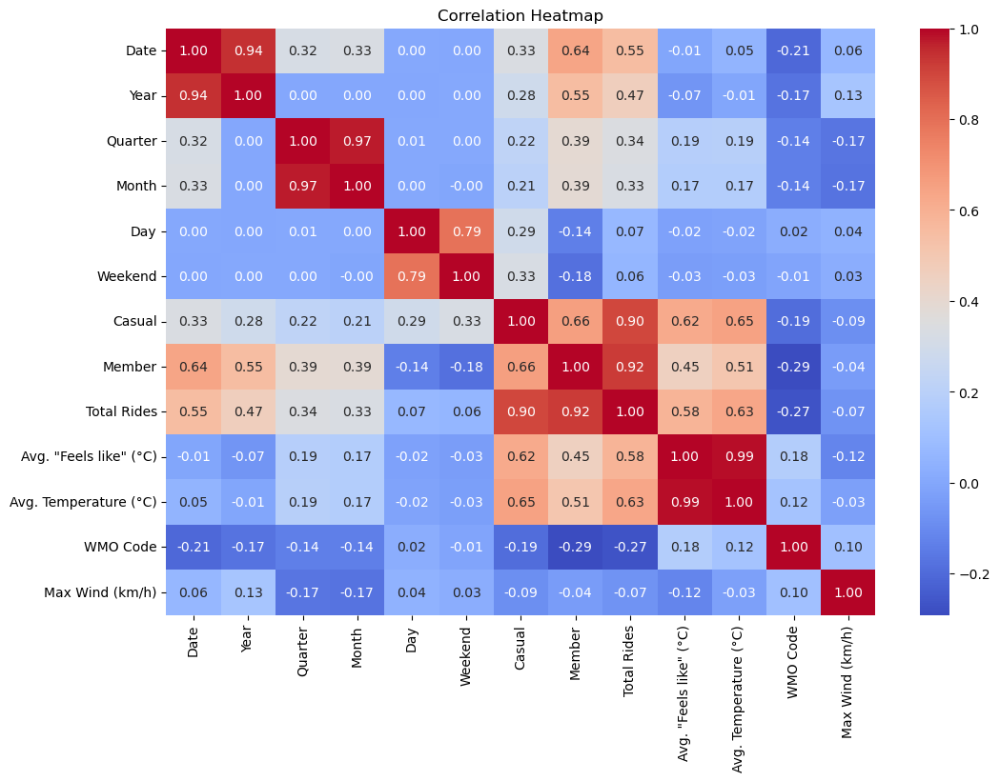

In [155]:
#heat map helps identify correlation between variables. Note that range from 1 to -1 indicates: 1 = correlation, 0 = no correlation, and -1 inverse correlation
correlation_matrix = df_DailyW_corr.corr()

# Plot a heatmap of the correlation matrix
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap')
plt.show()

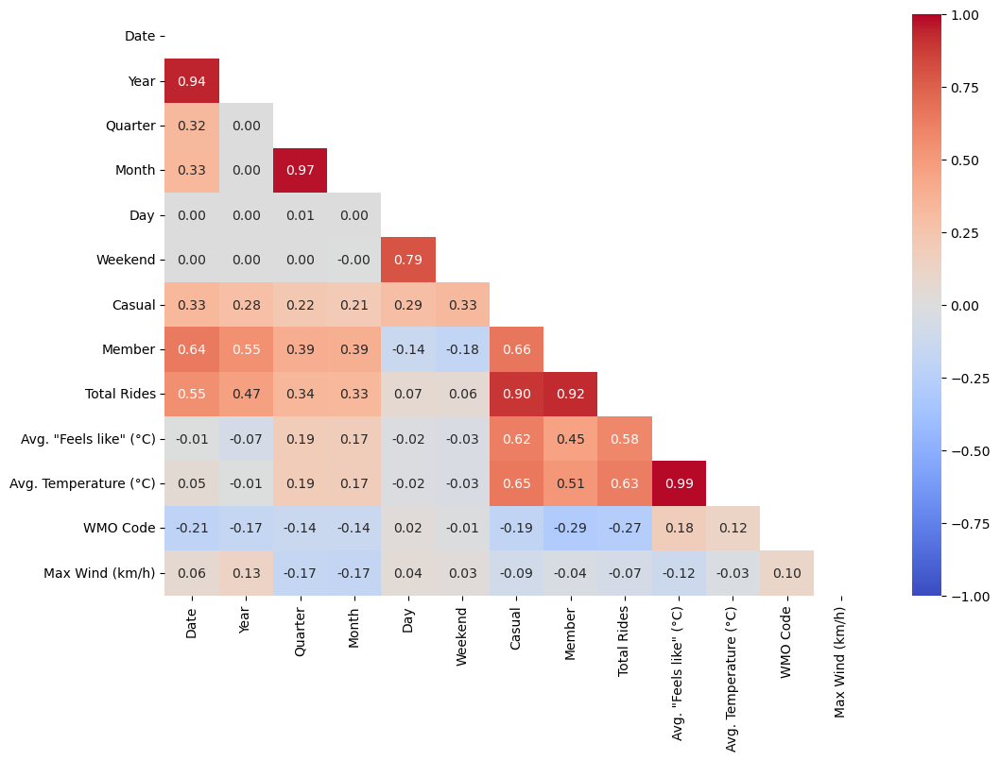

In [156]:
plt.figure(figsize=(12,8))
corr= df_DailyW_corr.corr()
matrix = np.triu(corr)
sns.heatmap(corr, annot=True, mask=matrix, vmin=-1, vmax=1, cmap='coolwarm', fmt=".2f")
plt.show()

In [157]:
df_selection = df_DailyW_corr[['Casual','Member', 'Total Rides', 'Avg. "Feels like" (°C)', 'Avg. Temperature (°C)', 'WMO Code', 'Max Wind (km/h)']]

In [158]:
df_selection.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1095 entries, 0 to 1094
Data columns (total 7 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Casual                  1095 non-null   int64  
 1   Member                  1095 non-null   int64  
 2   Total Rides             1095 non-null   int64  
 3   Avg. "Feels like" (°C)  1095 non-null   float64
 4   Avg. Temperature (°C)   1095 non-null   float64
 5   WMO Code                1095 non-null   int64  
 6   Max Wind (km/h)         1095 non-null   float64
dtypes: float64(3), int64(4)
memory usage: 60.0 KB


<Axes: xlabel='Avg. Temperature (°C)', ylabel='Total Rides'>

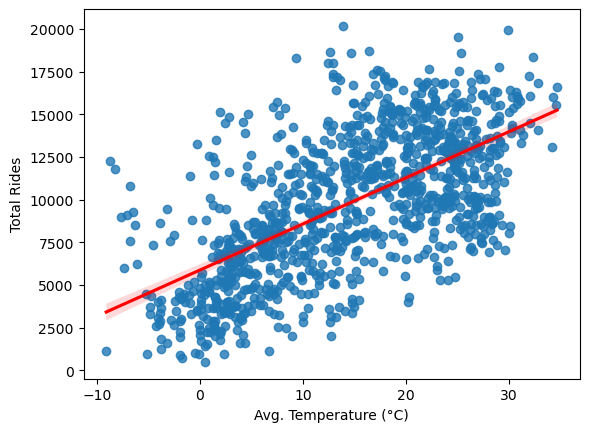

In [159]:
# plotting rides correlation to temperature to observe pattern that could indicate use of linear or polynomial regression
sns.regplot(x=df_selection['Avg. Temperature (°C)'],y=df_selection['Total Rides'], line_kws=dict(color="r"))

<Axes: xlabel='Avg. "Feels like" (°C)', ylabel='Total Rides'>

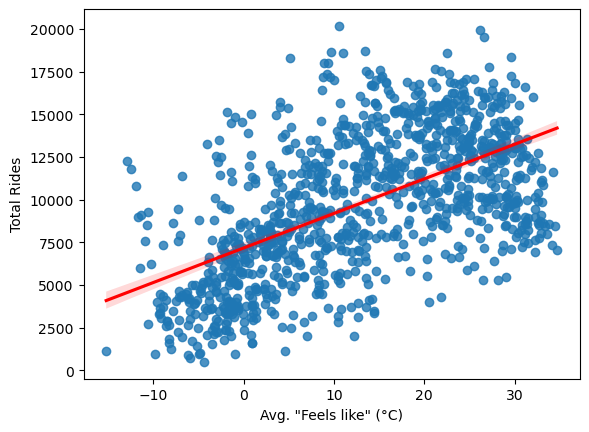

In [160]:
# plotting rides correlation to temperature to observe pattern that could indicate use of linear or polynomial regression
sns.regplot(x=df_selection['Avg. "Feels like" (°C)'],y=df_selection['Total Rides'], line_kws=dict(color="r"))

<Axes: xlabel='Max Wind (km/h)', ylabel='Total Rides'>

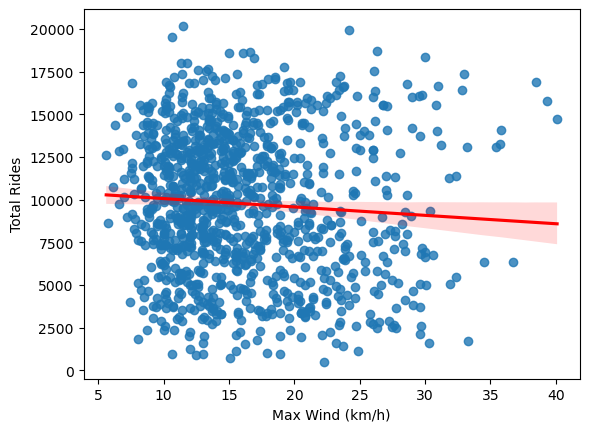

In [161]:
# plotting rides correlation with wind to observe pattern that could indicate use of linear or polynomial regression
sns.regplot(x=df_selection['Max Wind (km/h)'],y=df_selection['Total Rides'], line_kws=dict(color="r"))

**Univariate Linear Regression ML models** 

In [162]:
# choosing specific values that will be used as input to the ML model

temperature = df_selection['Avg. "Feels like" (°C)']
wind = df_selection['Max Wind (km/h)']
rides = df_selection['Total Rides']

In [163]:
# reshaping to a data frame format to work with the ML models
temperature = temperature.values.reshape(-1, 1)
wind = wind.values.reshape(-1, 1)
rides = rides.values.reshape(-1, 1)

In [164]:
# splitting the data into train and test data, using wind and rides

wind_train, wind_test, rides_train, rides_test = train_test_split(wind, rides, test_size=0.2, random_state=0)

In [165]:
# fitting the data to the ML model 
LinReg = linear_model.LinearRegression()
LinReg.fit(wind_train, rides_train)

LinearRegression()

In [166]:
# testing the accuracy of the ML model (note accuracy score is not very accurate)

reg_wind_score = (LinReg.score(wind_test, rides_test) * 100).round(2)
print("The accuracy of the ML model based on wind is:", reg_wind_score , "%")

The accuracy of the ML model based on wind is: -2.31 %


In [167]:
# predicting daily rides based on an arbitrary wind speed

wind_pred = 36

pred_1 = LinReg.predict([[wind_pred]]) 

print(f"With a wind speed of {wind_pred} km/h, total number of rides will be: {pred_1} and is {reg_wind_score}% accurate" )

With a wind speed of 36 km/h, total number of rides will be: [[8544.67183427]] and is -2.31% accurate


In [168]:
# splitting the data into train and test data, using temperature and rides

temperature_train, temperature_test, rides_train, rides_test = train_test_split(temperature, rides, test_size=0.2, random_state=0)

In [169]:
# fitting the data to the ML model 

LinReg = linear_model.LinearRegression()
LinReg.fit(temperature_train, rides_train)

LinearRegression()

In [170]:
# testing the accuracy of the ML model (note accuracy score is not very accurate)

reg_temperature_score = (LinReg.score(temperature_test, rides_test) * 100).round(2)
print("The accuracy of the ML model based on temperature is:", reg_temperature_score , "%")

The accuracy of the ML model based on temperature is: 33.04 %


In [171]:
# predicting daily rides based on an arbitrary temperature

temperature_pred = 23

pred_2 = LinReg.predict([[temperature_pred]]) 

print(f"With a temperature of {temperature_pred}°C, the total number of rides will be: {pred_2} and is {reg_temperature_score}% accurate" )

With a temperature of 23°C, the total number of rides will be: [[11659.85817282]] and is 33.04% accurate


**Multivariate Linear Regression ML models**

In [172]:
df_DailyW_corr.head()

,Date,Year,Quarter,Month,Day,Weekend,Casual,Member,Total Rides,"Avg. ""Feels like"" (°C)",Avg. Temperature (°C),WMO Code,Max Wind (km/h)
0,2021-01-01,2021,1,1,5,0,371,590,961,-0.9,2.3,63,10.6
1,2021-01-02,2021,1,1,6,1,2874,2844,5718,4.8,7.6,61,19.1
2,2021-01-03,2021,1,1,7,1,495,1133,1628,0.9,3.9,63,13.0
3,2021-01-04,2021,1,1,1,0,907,2074,2981,1.0,4.1,3,13.3
4,2021-01-05,2021,1,1,2,0,1057,2004,3061,1.4,4.0,51,9.2


In [173]:
# selecting numeric columns to perform multivariate linear regression
df_DailyW_corr_1 = df_DailyW_corr.drop(columns=['Date', 'Year', 'Quarter', 'Month', 'Day', 'Weekend', 'Casual', 'Member', 'WMO Code'])

In [174]:
df_DailyW_corr_1.head()

,Total Rides,"Avg. ""Feels like"" (°C)",Avg. Temperature (°C),Max Wind (km/h)
0,961,-0.9,2.3,10.6
1,5718,4.8,7.6,19.1
2,1628,0.9,3.9,13.0
3,2981,1.0,4.1,13.3
4,3061,1.4,4.0,9.2


In [175]:
# selecting my target feature to be predicted

rides = df_DailyW_corr_1['Total Rides']
rides = rides.values.reshape(-1, 1)

In [176]:
# selecting the data which will be fed into the model

feats = df_DailyW_corr_1.drop(columns=['Total Rides'])

In [177]:
# splitting the data
feats_train, feats_test, rides_train, rides_test = train_test_split(feats, rides, test_size=0.3, random_state=23)

In [178]:
LinReg = linear_model.LinearRegression()
LinReg.fit(feats_train, rides_train)

LinearRegression()

In [179]:
score_multi = (LinReg.score(feats_test, rides_test)*100).round(2)
print('The coefficient of determination (r-squared) score of the Linear Regression ML model is:', score_multi,'%')



The coefficient of determination (r-squared) score of the Linear Regression ML model is: 54.35 %


In [180]:
# of the house you want to predict the price for. 

predictions = [-2.1, 3.4, 15]
pred_multi = LinReg.predict([predictions]) 

c:\Users\EWF\anaconda3\Lib\site-packages\sklearn\base.py:493: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


In [181]:
print(f"With the following weather conditions:\n"
f"\nAvg. Feels like: {predictions[0]} °C"
f"\nActual Temperature: {predictions[1]} °C"
f"\nWind speed: {predictions[2]} km/h"
f"\n\nTotal Rides per day will sum up to: {pred_multi}"
f"\n\nThis model is {score_multi}% accurate" )

With the following weather conditions:

Avg. Feels like: -2.1 °C
Actual Temperature: 3.4 °C
Wind speed: 15 km/h

Total Rides per day will sum up to: [[8842.6436071]]

This model is 54.35% accurate


**Polynomial regression**

In [182]:
df_DailyW_corr_1.head()

,Total Rides,"Avg. ""Feels like"" (°C)",Avg. Temperature (°C),Max Wind (km/h)
0,961,-0.9,2.3,10.6
1,5718,4.8,7.6,19.1
2,1628,0.9,3.9,13.0
3,2981,1.0,4.1,13.3
4,3061,1.4,4.0,9.2


In [183]:
# using polynomial regression with multivariate features splitted above to predict total rides
# splitting of data has been implemented above 

X = df_DailyW_corr_1.drop(columns=['Total Rides'])
y = df_DailyW_corr_1['Total Rides']


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=25)

poly_1 = PolynomialFeatures(degree = 2)
X_train_poly = poly_1.fit_transform(X_train)
X_test_poly = poly_1.transform(X_test)
  
model = LinearRegression()

model.fit(X_train_poly, y_train)

y_pred = model.predict(X_test_poly)
mse = mean_squared_error(y_test, y_pred)
print("The Mean Squared Error of the Polynomial ML model is:", mse)

score_polynomial = (model.score(X_test_poly, y_test)*100).round(2)
print('The Accuracy Score of the Polynomial ML model is:', score_polynomial,'%')

r_squared = r2_score(y_test, y_pred)
print('The R-squared Score of the Polynomial ML model is:', r_squared)

The Mean Squared Error of the Polynomial ML model is: 7727902.804288629
The Accuracy Score of the Polynomial ML model is: 55.07 %
The R-squared Score of the Polynomial ML model is: 0.5507157337005173


In [184]:
X.head()

,"Avg. ""Feels like"" (°C)",Avg. Temperature (°C),Max Wind (km/h)
0,-0.9,2.3,10.6
1,4.8,7.6,19.1
2,0.9,3.9,13.0
3,1.0,4.1,13.3
4,1.4,4.0,9.2


In [185]:
# Get the feature names after transformation
feature_names = poly_1.get_feature_names_out()

# Print the feature names
print("Feature names after transformation:", feature_names)

Feature names after transformation: ['1' 'Avg. "Feels like" (°C)' 'Avg. Temperature (°C)' 'Max Wind (km/h)'
 'Avg. "Feels like" (°C)^2' 'Avg. "Feels like" (°C) Avg. Temperature (°C)'
 'Avg. "Feels like" (°C) Max Wind (km/h)' 'Avg. Temperature (°C)^2'
 'Avg. Temperature (°C) Max Wind (km/h)' 'Max Wind (km/h)^2']


In [186]:
# Get the number of output features
num_output_features = poly_1.n_output_features_

# Print the number of output features
print("Number of output features:", num_output_features)

Number of output features: 10


In [187]:
# After fitting the model
coefficients = model.coef_

# Print the coefficients for each feature
for i, coef in enumerate(coefficients):
    print(f'Coefficient for feature {i}: {coef}')

Coefficient for feature 0: 0.0
Coefficient for feature 1: -2720.326208494898
Coefficient for feature 2: 3633.215647379787
Coefficient for feature 3: -689.0111214593193
Coefficient for feature 4: -98.42776640888013
Coefficient for feature 5: 275.9090289923655
Coefficient for feature 6: -10.52400987464115
Coefficient for feature 7: -191.23141854216163
Coefficient for feature 8: 23.52821573763046
Coefficient for feature 9: 5.743337411283755


In [188]:
importance = np.abs(coefficients)

# Print the importance of each feature
for i, imp in enumerate(importance):
    print(f'Importance of feature {i}: {imp}')

Importance of feature 0: 0.0
Importance of feature 1: 2720.326208494898
Importance of feature 2: 3633.215647379787
Importance of feature 3: 689.0111214593193
Importance of feature 4: 98.42776640888013
Importance of feature 5: 275.9090289923655
Importance of feature 6: 10.52400987464115
Importance of feature 7: 191.23141854216163
Importance of feature 8: 23.52821573763046
Importance of feature 9: 5.743337411283755


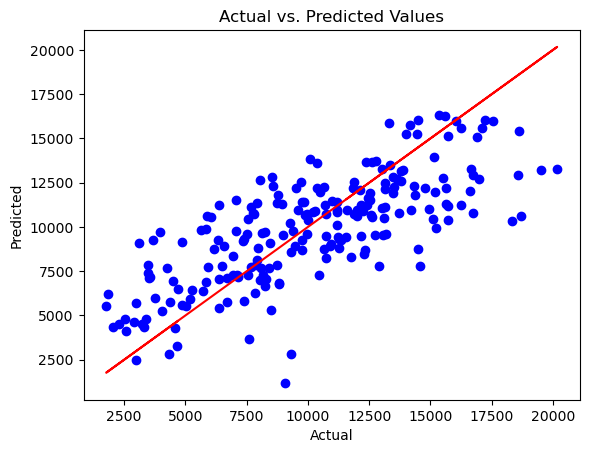

In [189]:
# Plot actual vs. predicted values
plt.scatter(y_test, y_pred, color='blue')
plt.plot(y_test, y_test, color='red')  # Identity line
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs. Predicted Values')
plt.show()

<Axes: xlabel='Total Rides'>

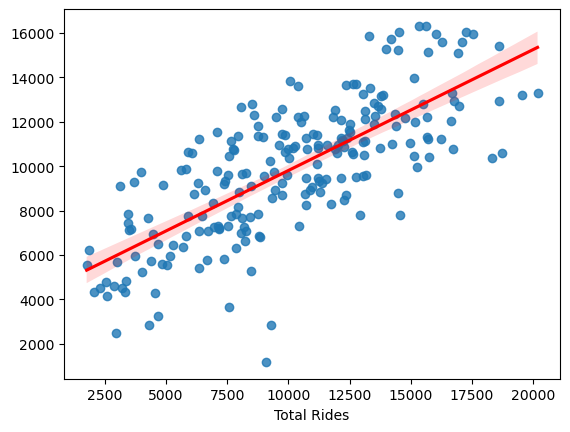

In [190]:
sns.regplot(x=y_test,y=y_pred, line_kws=dict(color="r"))

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11]),
 [Text(0, 0, 'January'),
  Text(1, 0, 'February'),
  Text(2, 0, 'March'),
  Text(3, 0, 'April'),
  Text(4, 0, 'May'),
  Text(5, 0, 'June'),
  Text(6, 0, 'July'),
  Text(7, 0, 'August'),
  Text(8, 0, 'September'),
  Text(9, 0, 'October'),
  Text(10, 0, 'November'),
  Text(11, 0, 'December')])

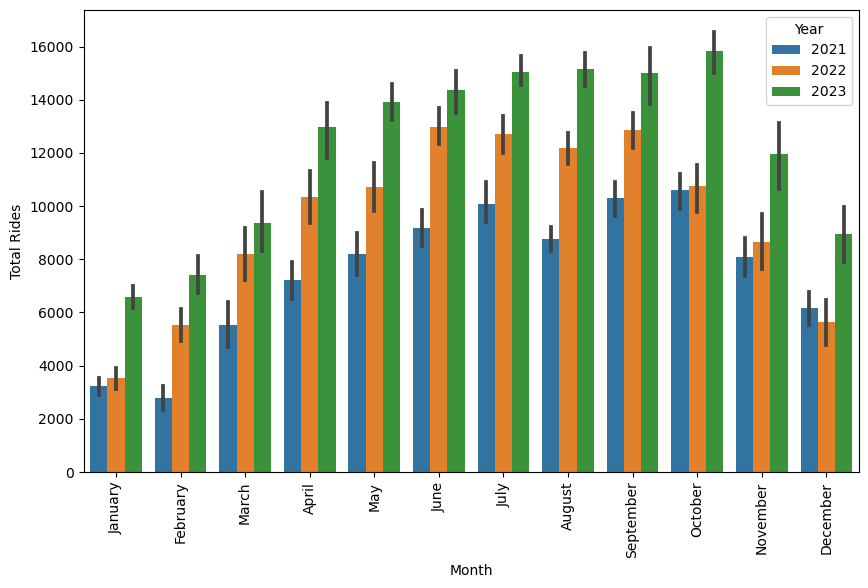

In [191]:
plt.figure(figsize=(10,6))
sns.barplot(df_DailyWeather, x='Month',y='Total Rides', hue='Year')
plt.xticks(rotation=90)